## 0: Importing the libraries

In [2]:
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt

plt.style.use('science.mplstyle') # comment this line if you don't have the style file
%config InlineBackend.figure_format='retina' # comment this line if you don't have a retina display
plt.rcParams['font.family'] = 'Times New Roman' # comment this line if you don't have the font

from sklearn.datasets import fetch_20newsgroups
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, TfidfVectorizer
from sklearn.cluster import KMeans,  AgglomerativeClustering, DBSCAN
from plotmat import plot_mat
from sklearn.metrics.cluster import contingency_matrix, homogeneity_score, completeness_score, adjusted_rand_score, adjusted_mutual_info_score, v_measure_score
from sklearn.decomposition import TruncatedSVD, NMF
import json

## Question 1

In [ ]:
# create the list of categories in each class
class1 = ['comp.graphics', 'comp.os.ms-windows.misc', 'comp.sys.ibm.pc.hardware', 'comp.sys.mac.hardware']
class2 = ['rec.autos', 'rec.motorcycles', 'rec.sport.baseball', 'rec.sport.hockey']

# load the data class-wise
dataClass1 = fetch_20newsgroups(subset='all', categories=class1, shuffle=True, random_state=0, remove=('headers', 'footers'))
dataClass2 = fetch_20newsgroups(subset='all', categories=class2, shuffle=True, random_state=0, remove=('headers', 'footers'))

# load the data combined
allData = fetch_20newsgroups(subset='train', categories=class1+class2, shuffle=True, random_state=0, remove=('headers', 'footers'))

# Vectorize data and get TF-IDF
vectorizer = CountVectorizer(stop_words='english', min_df=3)
counts = vectorizer.fit_transform(allData.data)
tfidfTran = TfidfTransformer()
features = tfidfTran.fit_transform(counts)
print(f"The dimensions of the TF-IDF matrix we obtain is {features.shape}")

The dimensions of the TF-IDF matrix we obtain is (4732, 17131)


## Question 2

The shape of the ground truth target vector is (4732,)


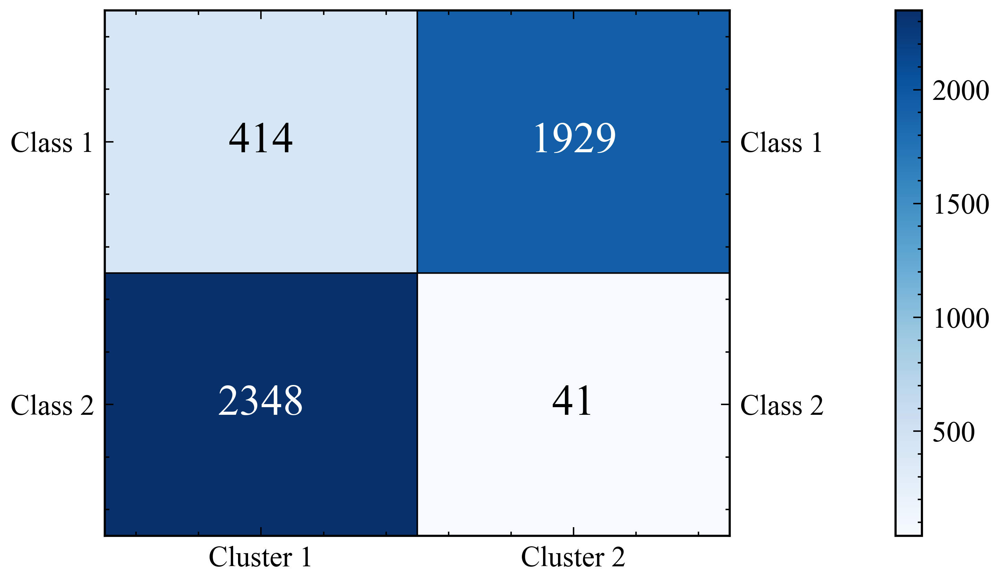

In [ ]:
# Create ground truth target vector for 2 classes (0,1)
allTargets = np.array([0 if i < 4 else 1 for i in allData.target])
print(f"The shape of the ground truth target vector is {allTargets.shape}")

# Clustering with K-means
kMeans = KMeans(n_clusters=2, random_state=42, max_iter=4000, n_init = 60)
kMeans.fit(features)
labels = kMeans.labels_

# Obtain the contingency table and plot it using plot_mat
contingency = contingency_matrix(allTargets, labels)
plot_mat(contingency, ['Cluster 1','Cluster 2'], ['Class 1','Class 2'], 'Q2.pdf', size=(5,3), textsize=15, padding = 0.2)

## Question 3

In [ ]:
# Calculate the metrics
homogeneity = homogeneity_score(allTargets, labels)
completeness = completeness_score(allTargets, labels)
vMeasure = v_measure_score(allTargets, labels)
adjustedRand = adjusted_rand_score(allTargets, labels)
adjustedMutual = adjusted_mutual_info_score(allTargets, labels)
print(f"The homogeneity score is :\t{homogeneity:.4f} \nThe completeness score is :\t{completeness:.4f} \nThe V-measure score is :\t{vMeasure:.4f} \nThe adjusted Rand Index is :\t{adjustedRand:.4f} \nThe adjusted MI score is :\t{adjustedMutual:.4f}")

The homogeneity score is :	0.5834 
The completeness score is :	0.5955 
The V-measure score is :	0.5894 
The adjusted Rand Index is :	0.6523 
The adjusted MI score is :	0.5893


## Question 4

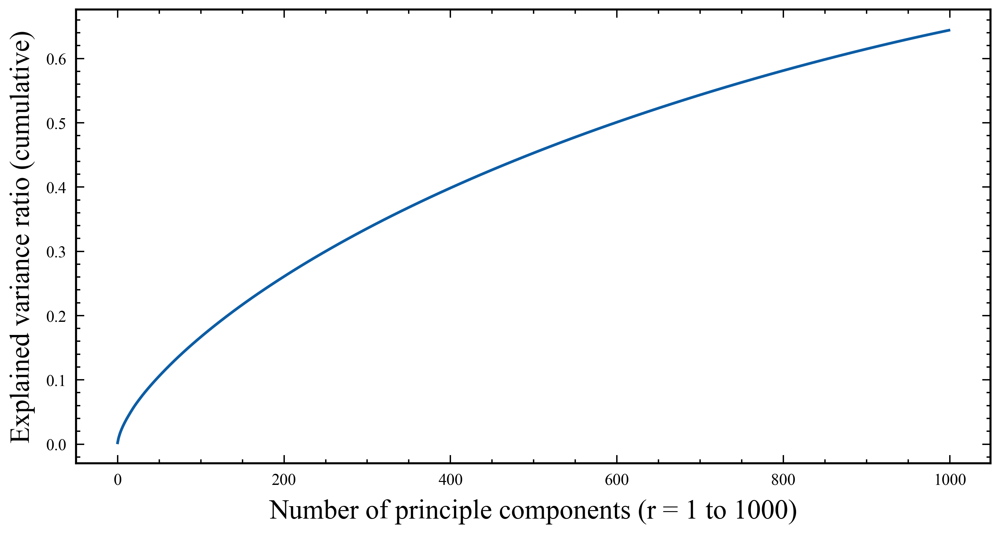

In [ ]:
# perform dimensionality reduction using SVD
svd = TruncatedSVD(n_components=1000, random_state=0)
svd.fit(features)

plt.figure(figsize=(6,3), dpi=300)
plt.plot(np.arange(1000),np.cumsum(svd.explained_variance_ratio_))
plt.xlabel("Number of principle components (r = 1 to 1000)")
plt.ylabel("Explained variance ratio (cumulative)")
plt.xticks(size=6)
plt.yticks(size=6)
plt.savefig("Q4.pdf", dpi=500, bbox_inches='tight')
plt.show()


## Question 5

In [ ]:
# Dont run this cell, it takes a lot of time to run, the results are stored in the json file.

# q5Scores = {'SVD':{}, 'NMF':{}} # dictionary to store the scores
# for k in q5Scores.keys():
#     q5Scores[k] = {}.fromkeys([1,2,3,4,5,6,7,8,9,10,20,50,100,300]) # dictionary for scores for diff values of r

# # SVD
# for r in tqdm(q5Scores['SVD'].keys()):#tqdm([20,50,100,300,1,2,3,4,5,6,7,8,9,10]):
#     #print(f"Solving SVD for r = {r}")
#     svd = TruncatedSVD(n_components=r, random_state=42)
#     svdFeatures = svd.fit_transform(features)
#     #print(f"Finished SVD for r = {r}")
#     #print(f"Fitting KMeans for r = {r}")
#     kMeans = KMeans(n_clusters=2, random_state=42, max_iter=4000, n_init = 60)
#     kMeans.fit(svdFeatures)
#     labels = kMeans.labels_
#     #print(f"Finished KMeans for r = {r}")
#     q5Scores['SVD'][r] = [homogeneity_score(allTargets, labels), completeness_score(allTargets, labels), v_measure_score(allTargets, labels), adjusted_rand_score(allTargets, labels), adjusted_mutual_info_score(allTargets, labels)]

# # NMF
# for r in tqdm(q5Scores['NMF'].keys()):#tqdm([100,50,20,300,1,2,3,4,5,6,7,8,9,10]):
#     nmf = NMF(n_components=r, random_state=42)
#     nmfFeatures = nmf.fit_transform(features)
#     kMeans = KMeans(n_clusters=2, random_state=42, max_iter=4000, n_init = 60)
#     kMeans.fit(nmfFeatures)
#     labels = kMeans.labels_
#     q5Scores['NMF'][r] = [homogeneity_score(allTargets, labels), completeness_score(allTargets, labels), v_measure_score(allTargets, labels), adjusted_rand_score(allTargets, labels), adjusted_mutual_info_score(allTargets, labels)]

# # save the scores as a JSON file
# with open('Q5Scores.json', 'w') as fp:
#     json.dump(q5Scores, fp)

In [ ]:
# load the scores from the JSON file
with open('Q5Scores.json', 'r') as fp:
    q5Scores = json.load(fp)
# convert score keys to int
for k in q5Scores.keys():
    q5Scores[k] = {int(r):q5Scores[k][r] for r in q5Scores[k].keys()}

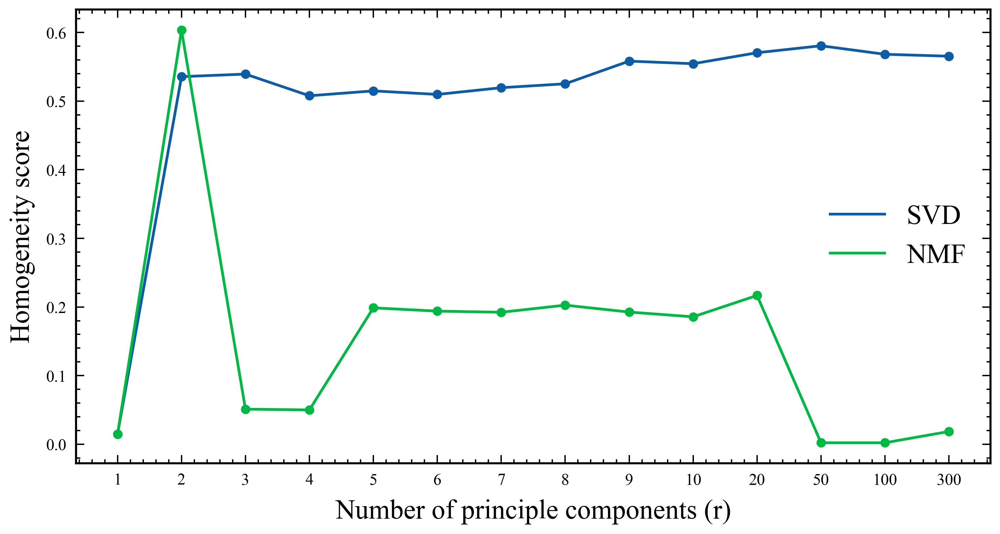

In [ ]:
# create line plots for SVD and NMF: Homogeneity score
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][0] for r in q5Scores['SVD'].keys()],label = 'SVD')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][0] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][0] for r in q5Scores['NMF'].keys()],label = 'NMF')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][0] for r in q5Scores['NMF'].keys()],s=6)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Homogeneity score")
plt.xticks(ticks=range(len(q5Scores['SVD'].keys())), labels=list(q5Scores['SVD'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q5a.pdf", dpi=500, bbox_inches='tight')
plt.show()

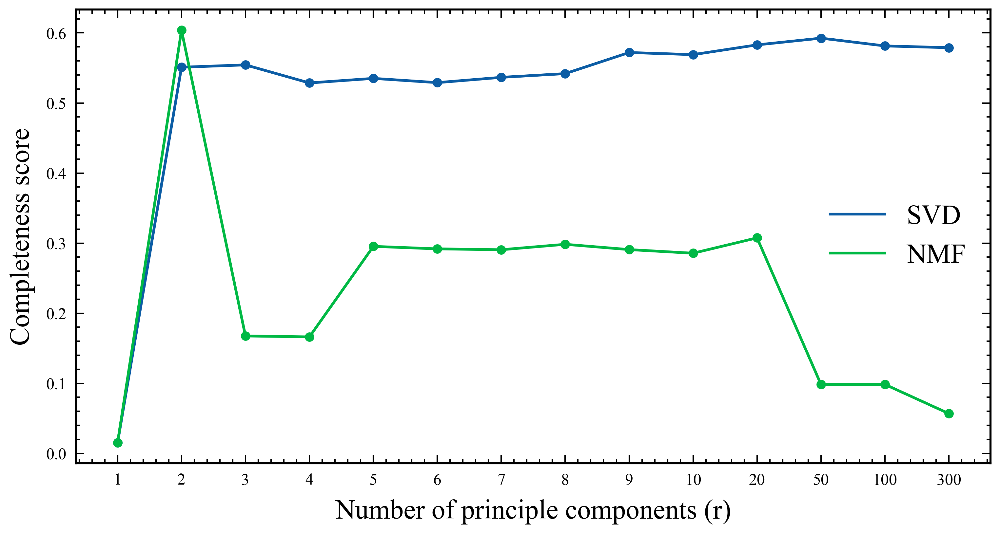

In [ ]:
# create line plots for SVD and NMF: Completeness score
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][1] for r in q5Scores['SVD'].keys()],label = 'SVD')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][1] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][1] for r in q5Scores['NMF'].keys()],label = 'NMF')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][1] for r in q5Scores['NMF'].keys()],s=6)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Completeness score")
plt.xticks(ticks=range(len(q5Scores['SVD'].keys())), labels=list(q5Scores['SVD'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q5b.pdf", dpi=500, bbox_inches='tight')
plt.show()

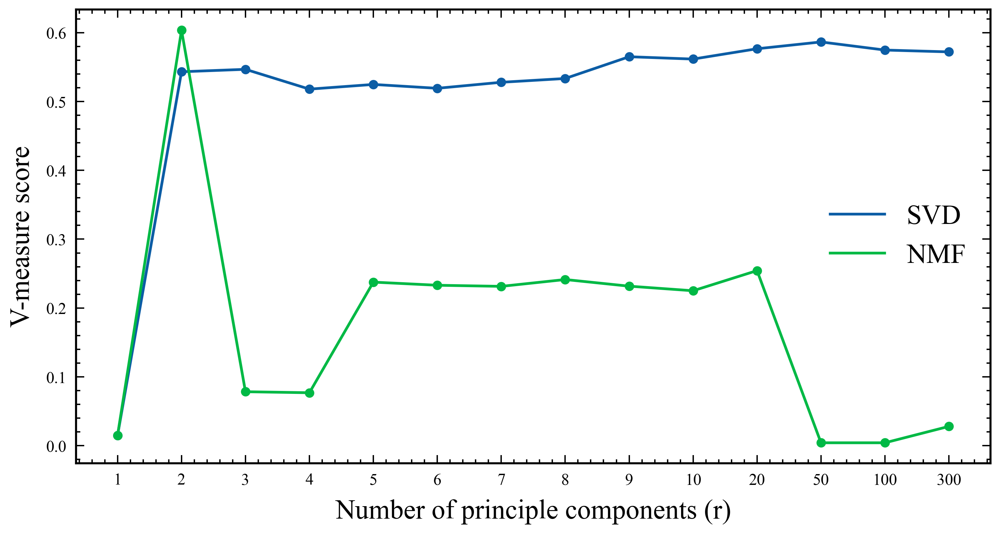

In [ ]:
# create line plots for SVD and NMF: V-measure score
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][2] for r in q5Scores['SVD'].keys()],label = 'SVD')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][2] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][2] for r in q5Scores['NMF'].keys()],label = 'NMF')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][2] for r in q5Scores['NMF'].keys()],s=6)
plt.xlabel("Number of principle components (r)")
plt.ylabel("V-measure score")
plt.xticks(ticks=range(len(q5Scores['SVD'].keys())), labels=list(q5Scores['SVD'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q5c.pdf", dpi=500, bbox_inches='tight')
plt.show()

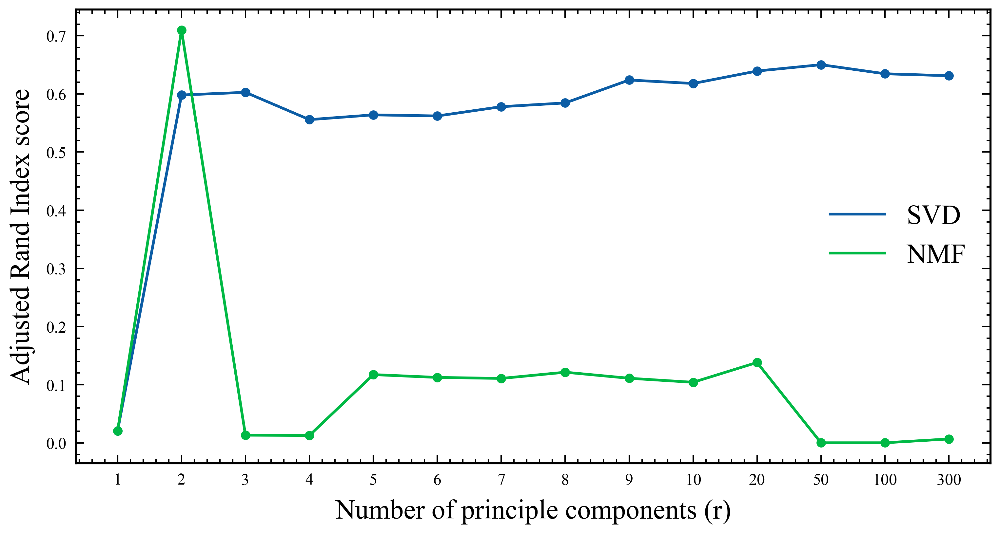

In [ ]:
# create line plots for SVD and NMF: Adjusted Rand score
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][3] for r in q5Scores['SVD'].keys()],label = 'SVD')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][3] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][3] for r in q5Scores['NMF'].keys()],label = 'NMF')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][3] for r in q5Scores['NMF'].keys()],s=6)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Adjusted Rand Index score")
plt.xticks(ticks=range(len(q5Scores['SVD'].keys())), labels=list(q5Scores['SVD'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q5d.pdf", dpi=500, bbox_inches='tight')
plt.show()

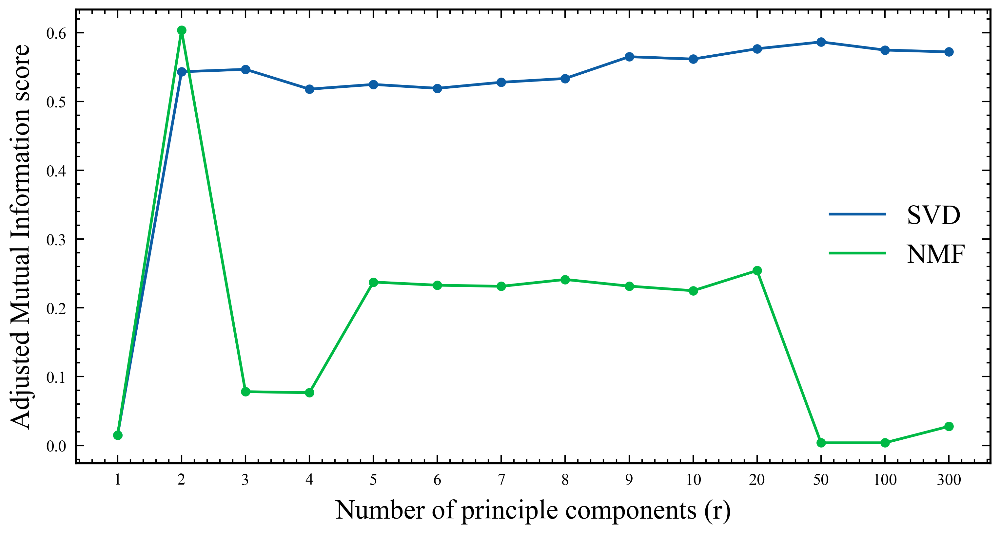

In [ ]:
# create line plots for SVD and NMF: Adjusted Mutual Info score
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][4] for r in q5Scores['SVD'].keys()],label = 'SVD')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][4] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][4] for r in q5Scores['NMF'].keys()],label = 'NMF')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][4] for r in q5Scores['NMF'].keys()],s=6)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Adjusted Mutual Information score")
plt.xticks(ticks=range(len(q5Scores['SVD'].keys())), labels=list(q5Scores['SVD'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q5e.pdf", dpi=500, bbox_inches='tight')
plt.show()

## Question 6

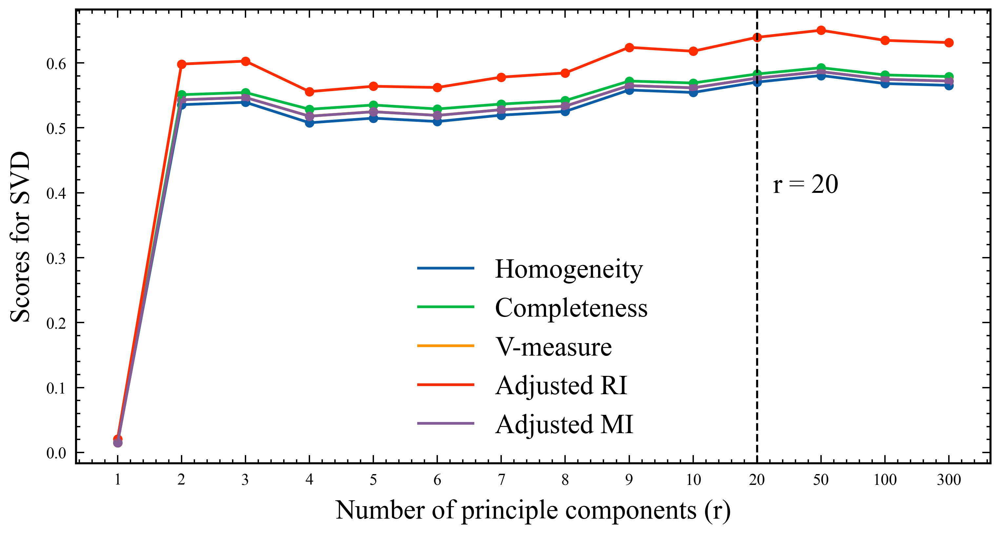

In [ ]:
# create a line plot with all scores for SVD
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][0] for r in q5Scores['SVD'].keys()],label = 'Homogeneity')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][0] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][1] for r in q5Scores['SVD'].keys()],label = 'Completeness')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][1] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][2] for r in q5Scores['SVD'].keys()],label = 'V-measure')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][2] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][3] for r in q5Scores['SVD'].keys()],label = 'Adjusted RI')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][3] for r in q5Scores['SVD'].keys()],s=6)
plt.plot(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][4] for r in q5Scores['SVD'].keys()],label = 'Adjusted MI')
plt.scatter(range(len(q5Scores['SVD'].keys())), [q5Scores['SVD'][r][4] for r in q5Scores['SVD'].keys()],s=6)
plt.axvline(x=10, color='k', linestyle='--',linewidth=0.75)
plt.annotate('r = 20', xy=(10, 0.4), xytext=(10.25, 0.4), size=10)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Scores for SVD")
plt.xticks(ticks=range(len(q5Scores['SVD'].keys())), labels=list(q5Scores['SVD'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q6a.pdf", dpi=500, bbox_inches='tight')
plt.show()

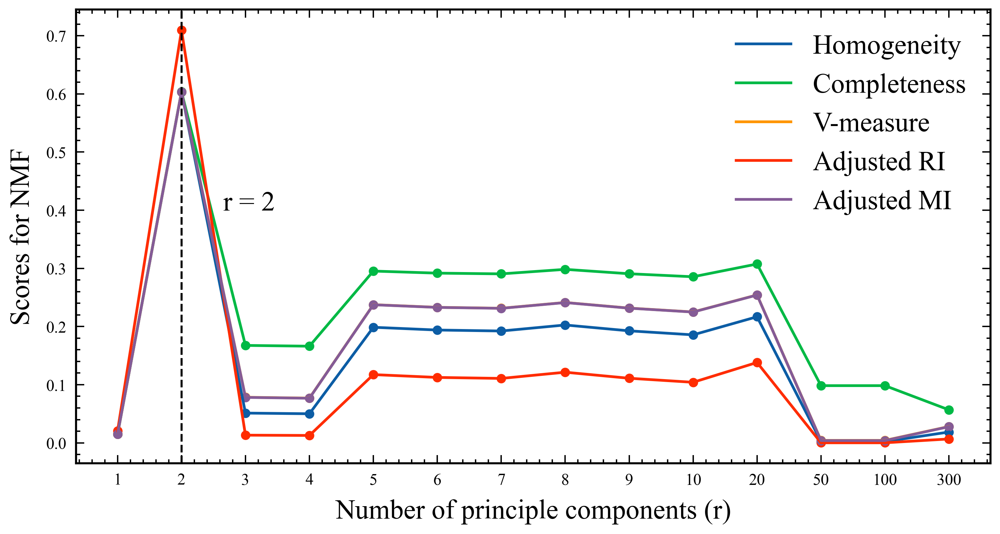

In [ ]:
# create a line plot with all scores for NMF
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][0] for r in q5Scores['NMF'].keys()],label = 'Homogeneity')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][0] for r in q5Scores['NMF'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][1] for r in q5Scores['NMF'].keys()],label = 'Completeness')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][1] for r in q5Scores['NMF'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][2] for r in q5Scores['NMF'].keys()],label = 'V-measure')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][2] for r in q5Scores['NMF'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][3] for r in q5Scores['NMF'].keys()],label = 'Adjusted RI')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][3] for r in q5Scores['NMF'].keys()],s=6)
plt.plot(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][4] for r in q5Scores['NMF'].keys()],label = 'Adjusted MI')
plt.scatter(range(len(q5Scores['NMF'].keys())), [q5Scores['NMF'][r][4] for r in q5Scores['NMF'].keys()],s=6)
plt.axvline(x=1, color='k', linestyle='--',linewidth=0.75)
plt.annotate('r = 2', xy=(1, 0.4), xytext=(1.65, 0.4), size=10)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Scores for NMF")
plt.xticks(ticks=range(len(q5Scores['NMF'].keys())), labels=list(q5Scores['NMF'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q6b.pdf", dpi=500, bbox_inches='tight')
plt.show()

## Question 7

In [ ]:
# create a table with all scores for SVD and NMF
print("SVD and NMF Scores")
print("r\tHomogeneity\tCompleteness\tV-measure\tAdjusted RI\tAdjusted MI")
for r in q5Scores['SVD'].keys():
    print(r, end="\t")
    for i in range(len(q5Scores['SVD'][r])):
        print("%.4f"%q5Scores['SVD'][r][i], end=" & ")
        print("%.4f"%q5Scores['NMF'][r][i], end=" & ")
    print()
# print scores from Q3
print(f"Q3\t{homogeneity:.4f}\t{completeness:.4f}\t{vMeasure:.4f}\t{adjustedRand:.4f}\t{adjustedMutual:.4f}")


SVD and NMF Scores
r	Homogeneity	Completeness	V-measure	Adjusted RI	Adjusted MI
1	0.0149 & 0.0149 & 0.0151 & 0.0151 & 0.0150 & 0.0150 & 0.0204 & 0.0204 & 0.0149 & 0.0149 & 
2	0.5356 & 0.6032 & 0.5510 & 0.6038 & 0.5432 & 0.6035 & 0.5982 & 0.7095 & 0.5431 & 0.6034 & 
3	0.5393 & 0.0512 & 0.5544 & 0.1675 & 0.5467 & 0.0784 & 0.6027 & 0.0132 & 0.5467 & 0.0782 & 
4	0.5077 & 0.0500 & 0.5286 & 0.1662 & 0.5180 & 0.0769 & 0.5558 & 0.0127 & 0.5179 & 0.0767 & 
5	0.5148 & 0.1987 & 0.5351 & 0.2954 & 0.5248 & 0.2376 & 0.5640 & 0.1173 & 0.5247 & 0.2375 & 
6	0.5097 & 0.1940 & 0.5290 & 0.2918 & 0.5192 & 0.2330 & 0.5621 & 0.1125 & 0.5191 & 0.2329 & 
7	0.5195 & 0.1923 & 0.5366 & 0.2906 & 0.5279 & 0.2314 & 0.5781 & 0.1108 & 0.5278 & 0.2313 & 
8	0.5252 & 0.2027 & 0.5419 & 0.2983 & 0.5334 & 0.2414 & 0.5845 & 0.1214 & 0.5333 & 0.2412 & 
9	0.5582 & 0.1926 & 0.5720 & 0.2908 & 0.5650 & 0.2317 & 0.6239 & 0.1111 & 0.5650 & 0.2316 & 
10	0.5544 & 0.1857 & 0.5690 & 0.2856 & 0.5616 & 0.2251 & 0.6179 & 0.1041 & 0.5616 &

## Question 8

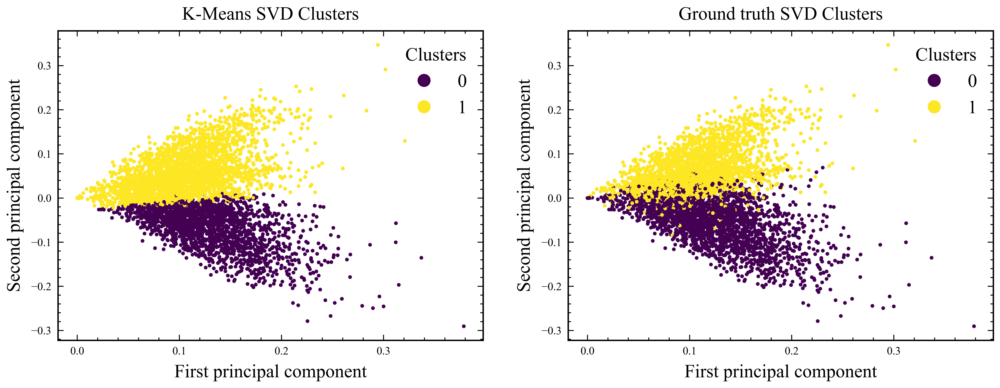

In [ ]:
# visualize clusters for SVD
svd = TruncatedSVD(n_components=20, random_state=42)
svdFeatures = svd.fit_transform(features)
kMeans = KMeans(n_clusters=2, random_state=42, max_iter=4000, n_init = 60)
kMeans.fit(svdFeatures)
labels = kMeans.labels_
svd2d = TruncatedSVD(n_components=2, random_state=42)
svdFeatures2d = svd2d.fit_transform(svdFeatures)
plt.figure(figsize=(9,3), dpi=600)
plt.subplot(1,2,1)
scatter = plt.scatter(svdFeatures2d[:,0], svdFeatures2d[:,1], c=labels, s=1)
plt.xlabel("First principal component")
plt.ylabel("Second principal component")
plt.xticks(size=6)    
plt.yticks(size=6)
plt.legend(*scatter.legend_elements(), loc="upper right", title="Clusters") 
plt.title("K-Means SVD Clusters",fontsize=10)
plt.subplot(1,2,2)
scatter = plt.scatter(svdFeatures2d[:,0], svdFeatures2d[:,1], c=allTargets, s=1)
plt.xlabel("First principal component")
plt.ylabel("Second principal component")
plt.xticks(size=6)    
plt.yticks(size=6)
plt.legend(*scatter.legend_elements(), loc="upper right", title="Clusters") 
plt.title("Ground truth SVD Clusters",fontsize=10)
plt.savefig("Q8a.pdf", dpi=600, bbox_inches='tight')
plt.show()


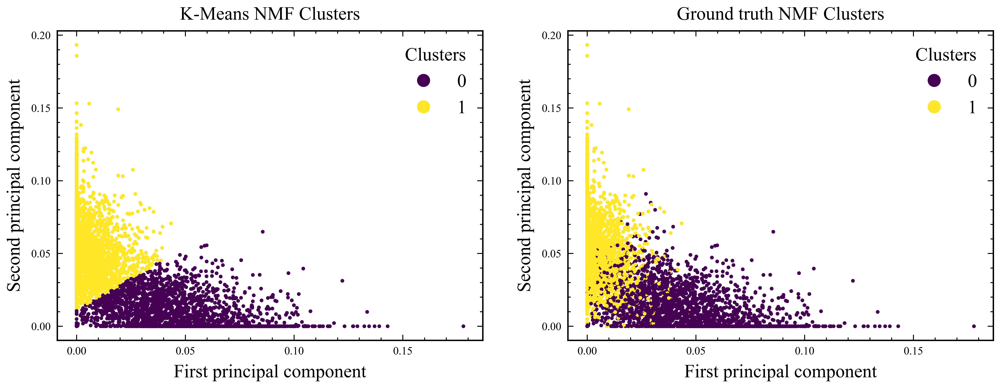

In [ ]:
# visualize clusters for NMF
nmf = NMF(n_components=2, random_state=42)
nmfFeatures = nmf.fit_transform(features)
kMeans = KMeans(n_clusters=2, random_state=42, max_iter=4000, n_init = 60)
kMeans.fit(nmfFeatures)
labels = kMeans.labels_
plt.figure(figsize=(9,3), dpi=600)
plt.subplot(1,2,1)
scatter = plt.scatter(nmfFeatures[:,0], nmfFeatures[:,1], c=labels, s=1)
plt.xlabel("First principal component")
plt.ylabel("Second principal component")
plt.xticks(size=6)    
plt.yticks(size=6)
plt.legend(*scatter.legend_elements(), loc="upper right", title="Clusters") 
plt.title("K-Means NMF Clusters",fontsize=10)
plt.subplot(1,2,2)
scatter = plt.scatter(nmfFeatures[:,0], nmfFeatures[:,1], c=allTargets, s=1)
plt.xlabel("First principal component")
plt.ylabel("Second principal component")
plt.xticks(size=6)    
plt.yticks(size=6)
plt.legend(*scatter.legend_elements(), loc="upper right", title="Clusters") 
plt.title("Ground truth NMF Clusters",fontsize=10)
plt.savefig("Q8b.pdf", dpi=600, bbox_inches='tight')
plt.show()

## Question 9

In [ ]:
# Explained in the report

## Question 10

In [ ]:
# load the data combined
allData = fetch_20newsgroups(subset='train', shuffle=True, random_state=0, remove=('headers', 'footers'))
# Vectorize data and get TF-IDF
vectorizer = CountVectorizer(stop_words='english', min_df=3)
counts = vectorizer.fit_transform(allData.data)
tfidfTran = TfidfTransformer()
features = tfidfTran.fit_transform(counts)
print(f"The dimensions of the TF-IDF matrix we obtain is {features.shape}")
allTargets = allData.target # get the targets

The dimensions of the TF-IDF matrix we obtain is (11314, 33551)


In [ ]:
# Don't run this code, it takes a long time to run. Use the Q10Scores.json file instead
# q10Scores = {'SVD':{}, 'NMF':{}} # dictionary to store the scores
# for k in q10Scores.keys():
#     q10Scores[k] = {}.fromkeys([1,2,3,4,5,6,7,8,9,10,20,50,100,300]) # dictionary for scores for diff values of r

# # loop over all values of r for SVD
# for r in tqdm([20,50,100,300,1,2,3,4,5,6,7,8,9,10]):#tqdm(q10Scores['SVD'].keys()):
#     svd = TruncatedSVD(n_components=r, random_state=42)
#     svdFeatures = svd.fit_transform(features)
#     kMeans = KMeans(n_clusters=20, random_state=42, max_iter=4000, n_init = 60)
#     kMeans.fit(svdFeatures)
#     labels = kMeans.labels_
#     q10Scores['SVD'][r] = [homogeneity_score(allTargets, labels), completeness_score(allTargets, labels), v_measure_score(allTargets, labels), adjusted_rand_score(allTargets, labels), adjusted_mutual_info_score(allTargets, labels)]

# # loop over all values of r for NMF
# for r in tqdm([100,50,20,300,1,2,3,4,5,6,7,8,9,10]):#tqdm(q5Scores['NMF'].keys()):#
#     nmf = NMF(n_components=r, random_state=42)
#     nmfFeatures = nmf.fit_transform(features)
#     kMeans = KMeans(n_clusters=20, random_state=42, max_iter=4000, n_init = 60)
#     kMeans.fit(nmfFeatures)
#     labels = kMeans.labels_
#     q10Scores['NMF'][r] = [homogeneity_score(allTargets, labels), completeness_score(allTargets, labels), v_measure_score(allTargets, labels), adjusted_rand_score(allTargets, labels), adjusted_mutual_info_score(allTargets, labels)]

# # save the Q-10 scores as a JSON file
# with open('Q10Scores.json', 'w') as fp:
#     json.dump(q10Scores, fp)

In [ ]:
# load the scores from the JSON file
with open('Q10Scores.json', 'r') as fp:
    q10Scores = json.load(fp)
# convert score keys to int
for k in q10Scores.keys():
    q10Scores[k] = {int(r):q10Scores[k][r] for r in q10Scores[k].keys()}

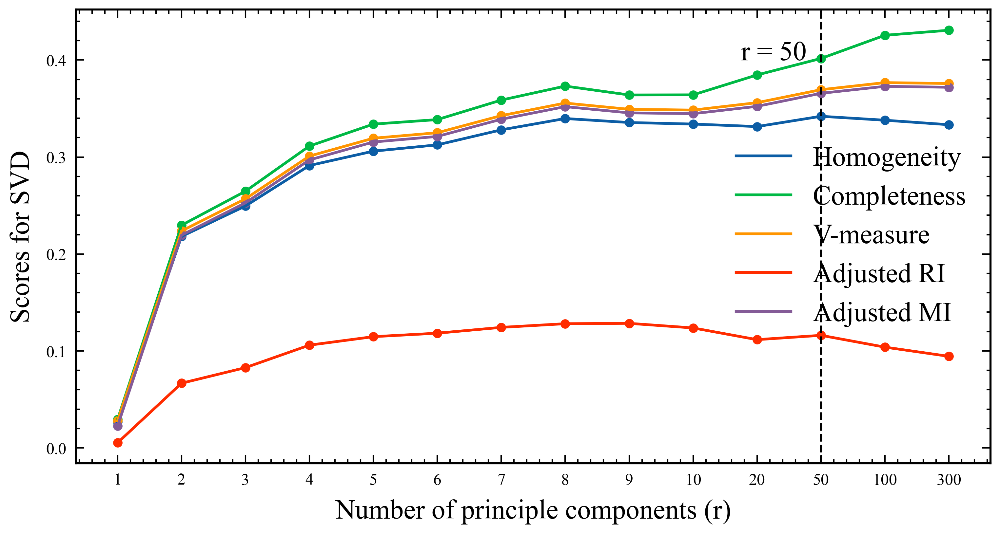

In [ ]:
# create a line plot with all scores for SVD
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][0] for r in q10Scores['SVD'].keys()],label = 'Homogeneity')
plt.scatter(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][0] for r in q10Scores['SVD'].keys()],s=6)
plt.plot(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][1] for r in q10Scores['SVD'].keys()],label = 'Completeness')
plt.scatter(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][1] for r in q10Scores['SVD'].keys()],s=6)
plt.plot(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][2] for r in q10Scores['SVD'].keys()],label = 'V-measure')
plt.scatter(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][2] for r in q10Scores['SVD'].keys()],s=6)
plt.plot(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][3] for r in q10Scores['SVD'].keys()],label = 'Adjusted RI')
plt.scatter(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][3] for r in q10Scores['SVD'].keys()],s=6)
plt.plot(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][4] for r in q10Scores['SVD'].keys()],label = 'Adjusted MI')
plt.scatter(range(len(q10Scores['SVD'].keys())), [q10Scores['SVD'][r][4] for r in q10Scores['SVD'].keys()],s=6)
plt.axvline(x=11, color='k', linestyle='--',linewidth=0.75)
plt.annotate('r = 50', xy=(11, 0.4), xytext=(9.75, 0.4), size=10)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Scores for SVD")
plt.xticks(ticks=range(len(q10Scores['SVD'].keys())), labels=list(q10Scores['SVD'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q10a.pdf", dpi=500, bbox_inches='tight')
plt.show()

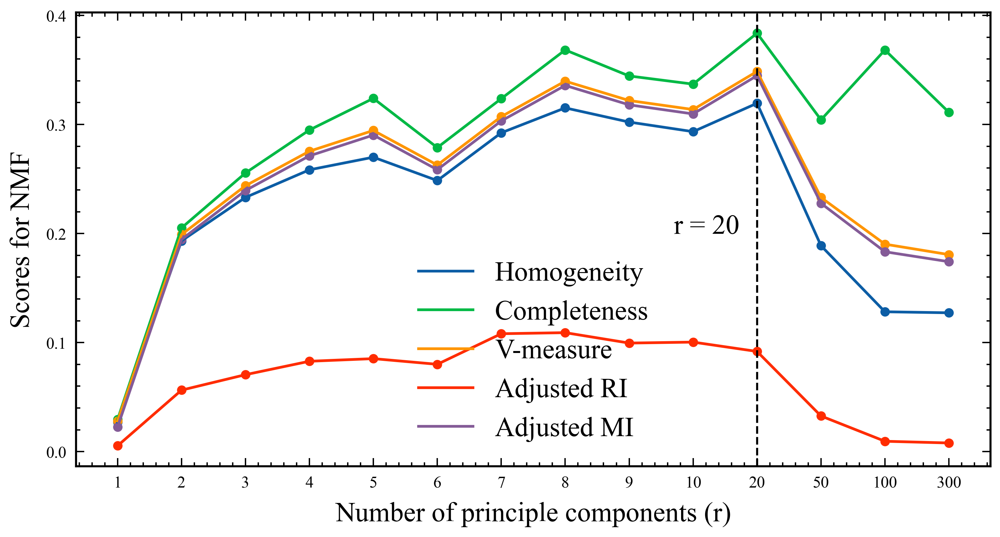

In [ ]:
# create a line plot with all scores for NMF
plt.figure(figsize=(6,3), dpi=300)
plt.plot(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][0] for r in q10Scores['NMF'].keys()],label = 'Homogeneity')
plt.scatter(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][0] for r in q10Scores['NMF'].keys()],s=6)
plt.plot(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][1] for r in q10Scores['NMF'].keys()],label = 'Completeness')
plt.scatter(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][1] for r in q10Scores['NMF'].keys()],s=6)
plt.plot(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][2] for r in q10Scores['NMF'].keys()],label = 'V-measure')
plt.scatter(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][2] for r in q10Scores['NMF'].keys()],s=6)
plt.plot(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][3] for r in q10Scores['NMF'].keys()],label = 'Adjusted RI')
plt.scatter(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][3] for r in q10Scores['NMF'].keys()],s=6)
plt.plot(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][4] for r in q10Scores['NMF'].keys()],label = 'Adjusted MI')
plt.scatter(range(len(q10Scores['NMF'].keys())), [q10Scores['NMF'][r][4] for r in q10Scores['NMF'].keys()],s=6)
plt.axvline(x=10, color='k', linestyle='--',linewidth=0.75)
plt.annotate('r = 20', xy=(10, 0.2), xytext=(8.7, 0.2), size=10)
plt.xlabel("Number of principle components (r)")
plt.ylabel("Scores for NMF")
plt.xticks(ticks=range(len(q10Scores['NMF'].keys())), labels=list(q10Scores['NMF'].keys()),size=6)
plt.yticks(size=6)
plt.legend()
plt.savefig("Q10b.pdf", dpi=500, bbox_inches='tight')
plt.show()

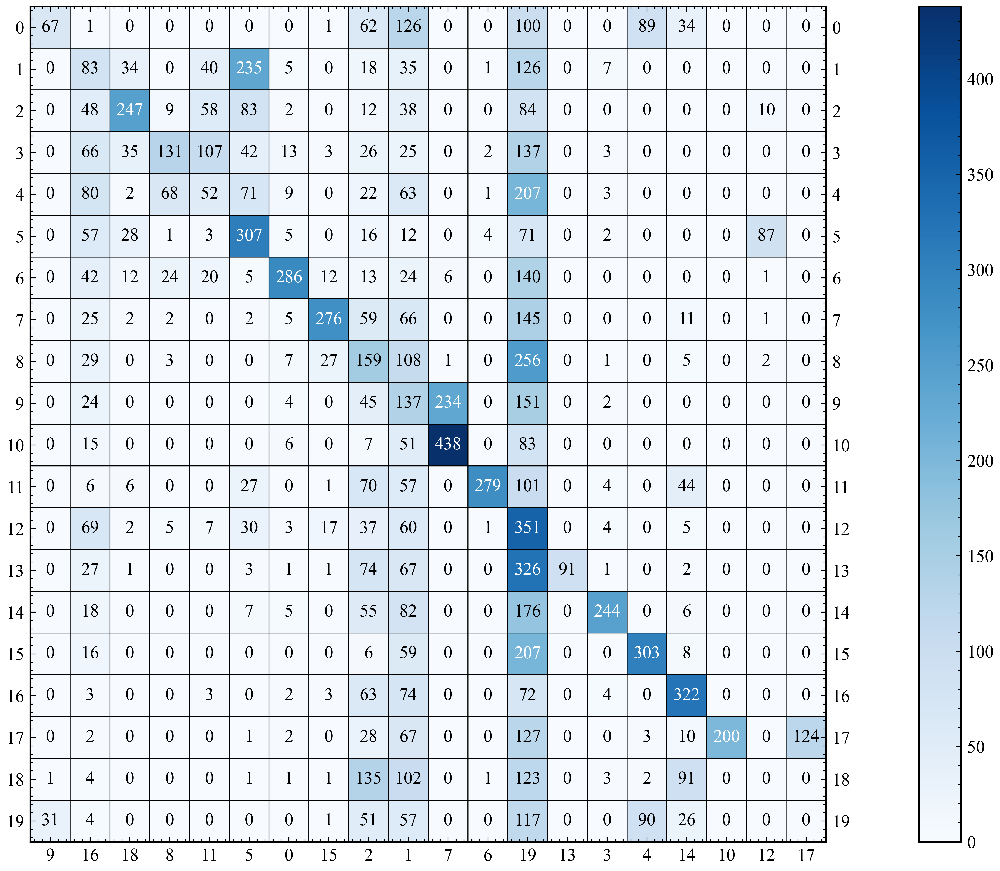

In [ ]:
# train a KMeans model with the best r for SVD and NMF and plot the confusion matrix
svd = TruncatedSVD(n_components=50, random_state=42)
svdFeatures = svd.fit_transform(features)
kMeans = KMeans(n_clusters=20, random_state=42, max_iter=4000, n_init = 60)
kMeans.fit(svdFeatures)
labels = kMeans.labels_
# Obtain the contingency table and plot it using plot_mat
contingency = contingency_matrix(allTargets, labels)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, 'Q10c.pdf', size=(8,7), textsize=10)

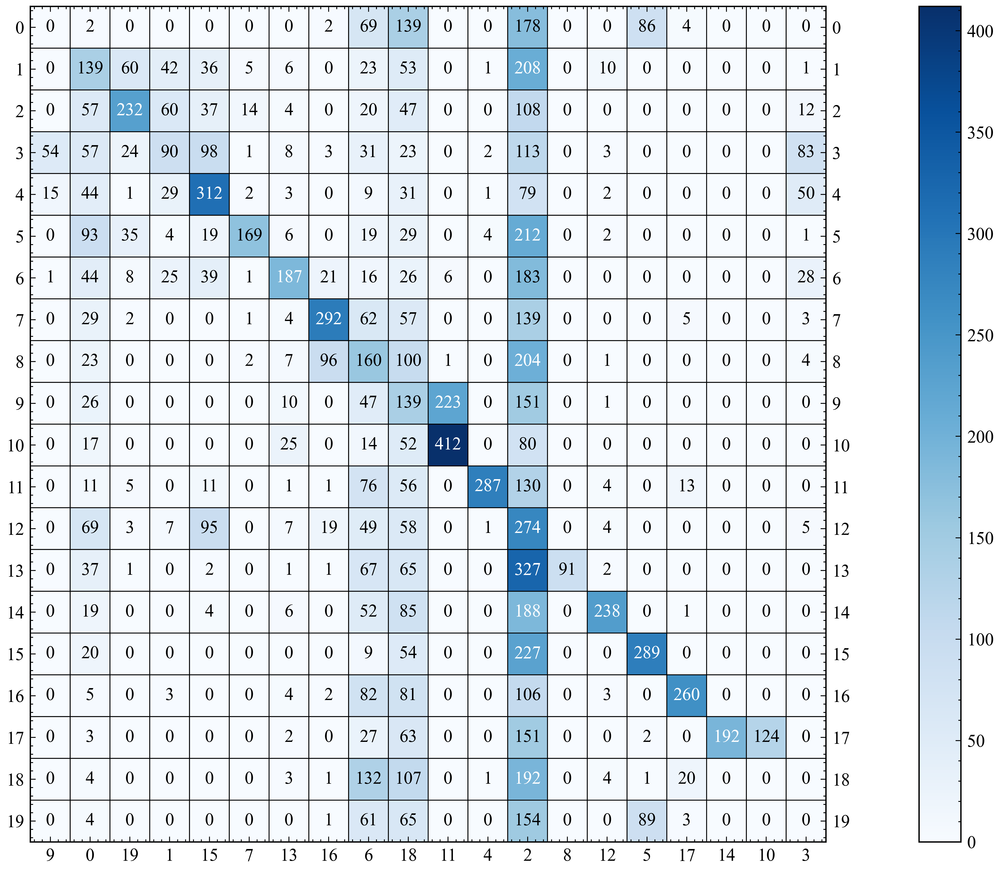

In [ ]:
nmf = NMF(n_components=20, random_state=42)
nmfFeatures = nmf.fit_transform(features)
kMeans = KMeans(n_clusters=20, random_state=42, max_iter=4000, n_init = 60)
kMeans.fit(nmfFeatures)
labels = kMeans.labels_
# Obtain the contingency table and plot it using plot_mat
contingency = contingency_matrix(allTargets, labels)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, 'Q10d.pdf', size=(8,7), textsize=10)

In [ ]:
print(f"SVD scores: {q10Scores['SVD'][50]}")
print(f"NMF scores: {q10Scores['NMF'][20]}")

SVD scores: [0.34197897122338994, 0.40161188687332433, 0.3694042722783463, 0.11612196033138018, 0.36568397114345474]
NMF scores: [0.31944279160923567, 0.38368708250516903, 0.3486299679535786, 0.09184002100274993, 0.34474341573916284]


## Question 11 

In [1]:
!pip3 install --pre umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 KB 2.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 18.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=4bb8f38ba167e38fc2422998df1f2190fa8dc3cab04aa3288de445e1f3bec113
  Stored in directory: /root/.cache/pip/wheels/a9/3a/67/06a8950e053725912e6a8c42c4a3a241410f6487b8402542ea
  Created wheel for pynndescent: filename=pynndescent-0.5.8-py3-none-any.whl size=55513 sha256=d6ffa3c16708e4c9bb86630c7f4259f66fbcbbe82f2b306c7b025c19eb120c89
  Stored in directory: /root/.cache/pip/wheels/1c/63/3a/29954bca1a27ba100ed8c27973a78cb71b43dc67aed62e80c3
Successfully built umap-learn pynndescent


In [38]:
import umap

In [ ]:
q11Scores = {'cosine':{}, 'euclidean':{}} # dictionary to store the scores
for k in q11Scores.keys():
     q11Scores[k] = {}.fromkeys([5, 20, 200]) # dictionary for scores for diff values of r

allTargets = all_class_data.target
# Cosine
for r in tqdm(q11Scores['cosine'].keys()):
    embedding = umap.UMAP(n_components=r, metric='cosine').fit(features)
    kMeans = KMeans(n_clusters=20, random_state=42, max_iter=4000, n_init = 60)
    kMeans.fit(embedding.embedding_)
    labels = kMeans.labels_
    q11Scores['cosine'][r] = [homogeneity_score(allTargets, labels), completeness_score(allTargets, labels), v_measure_score(allTargets, labels), adjusted_rand_score(allTargets, labels), adjusted_mutual_info_score(allTargets, labels), [labels.tolist()]]

# Euclidean
for r in tqdm(q11Scores['euclidean'].keys()):
    embedding = umap.UMAP(n_components=r, metric='euclidean').fit(features)
    kMeans = KMeans(n_clusters=20, random_state=42, max_iter=4000, n_init = 60)
    kMeans.fit(embedding.embedding_)
    labels = kMeans.labels_
    q11Scores['euclidean'][r] = [homogeneity_score(allTargets, labels), completeness_score(allTargets, labels), v_measure_score(allTargets, labels), adjusted_rand_score(allTargets, labels), adjusted_mutual_info_score(allTargets, labels), [labels.tolist()]]



# save the scores as a JSON file
with open('Q11Scores.json', 'w') as fp:
     json.dump(q11Scores, fp)

In [39]:
import json 

In [40]:
with open('Q11Scores.json') as json_file:
    data = json.load(json_file)

In [41]:
import pandas as pd 

In [42]:
df = pd.DataFrame(columns = ["metric", "r", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])

for metric in data:

  for r in data[metric]:

    df2 = pd.DataFrame(data = [[metric, r] + data[metric][r][:-1]], columns = ["metric", "r", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
    df = df.append(df2, ignore_index = True)

df

/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_5272/1915396318.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_5272/1915396318.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_5272/1915396318.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_5272/1915396318.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.appen

,metric,r,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,cosine,5,0.576583,0.596703,0.586471,0.458835,0.585101
1,cosine,20,0.568793,0.595022,0.581612,0.442332,0.580221
2,cosine,200,0.570496,0.591969,0.581034,0.450329,0.579645
3,euclidean,5,0.009504,0.009753,0.009627,0.001247,0.006397
4,euclidean,20,0.008718,0.008874,0.008795,0.001136,0.005540
5,euclidean,200,0.008229,0.008549,0.008386,0.001065,0.005152


We see that the performance for the cosine metric is a lot better than that of the euclidean metric 

In [83]:
all_class_data.target_names[12]

'sci.electronics'

In [64]:
print(all_class_data.data[0])

FOR SALE

                 1945 King Feature Syndicate
                 Jaymar Specialty Company
                 200 Fifth Avenue New York, NY

                 Cardboard puzzle - NO BOX
                 Pieces worn from use
                 NO MISSING PIECES
                 Size: 13 3/4 inches by 21 1/2 inches
                 60 Puzzle Pieces

   Puzzle depicts Dagwood, Blondie, the kids, and dog Daisey with her
   puppies on a picnic with Dagwood and Alexander trying to get
   a fishing line out of a tree.


In [65]:
print(all_class_data.target[0])

6


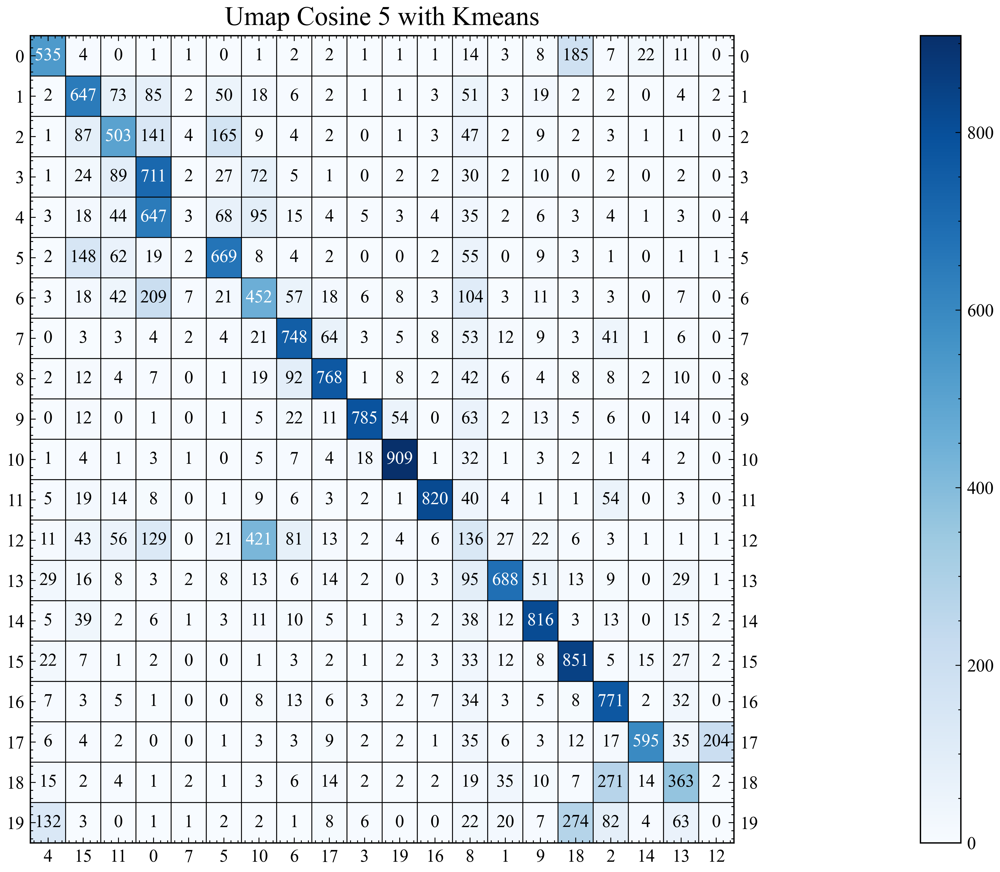

In [53]:
# Contigency matrix for cosine, 5 

labels_cosine_5 = np.array(data["cosine"]["5"][-1][0])

contingency = contingency_matrix(allTargets, labels_cosine_5)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, title = "Umap Cosine 5 with Kmeans", pic_fname = "Q11a.pdf", size=(8,7), textsize=10)


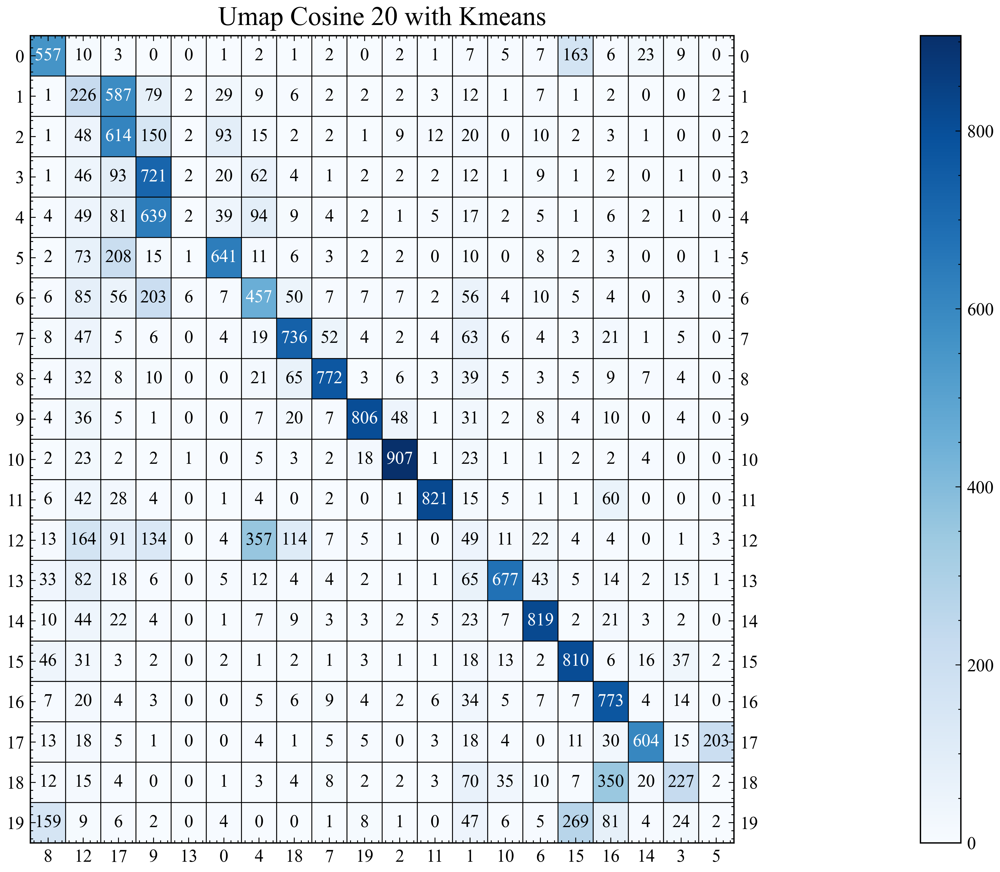

In [54]:
# Contigency matrix for cosine, 20 

labels_cosine_20 = np.array(data["cosine"]["20"][-1][0])
contingency = contingency_matrix(allTargets, labels_cosine_20)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, title = "Umap Cosine 20 with Kmeans", pic_fname = "Q11b.pdf", size=(8,7), textsize=10)



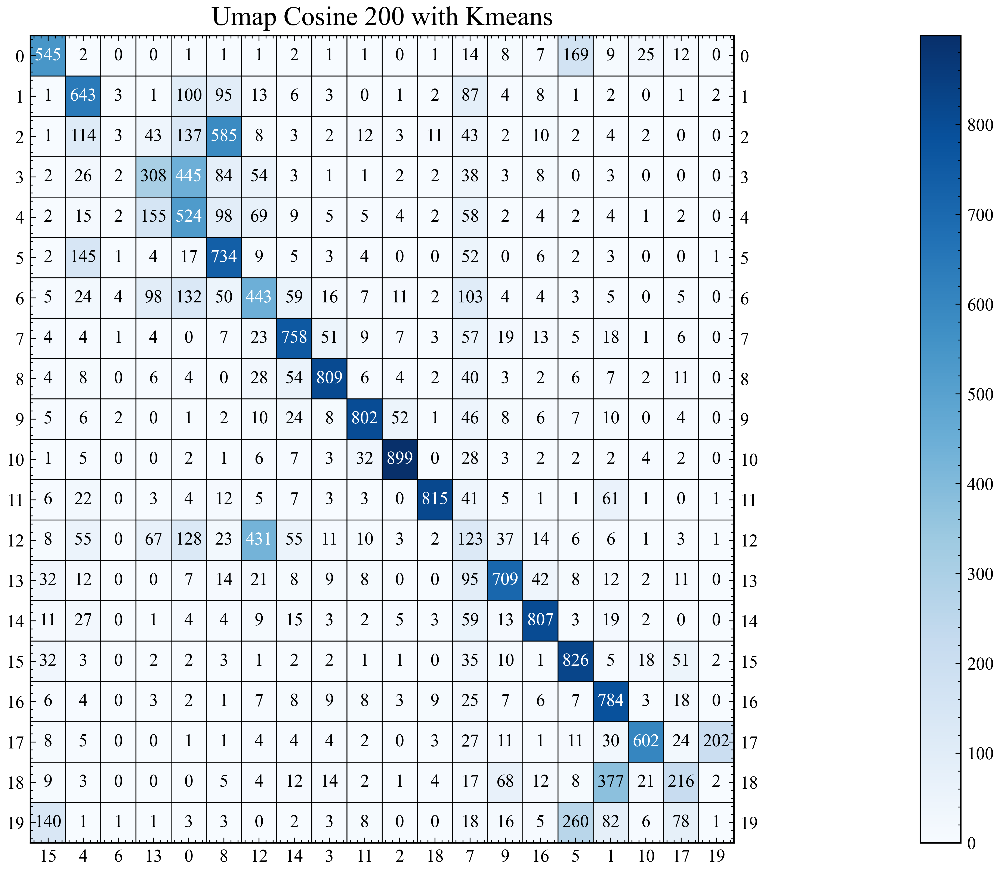

In [55]:
# Contigency matrix for cosine, 200

labels_cosine_200 = np.array(data["cosine"]["200"][-1][0])
contingency = contingency_matrix(allTargets, labels_cosine_200)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, title = "Umap Cosine 200 with Kmeans", pic_fname = "Q11c.pdf", size=(8,7), textsize=10)



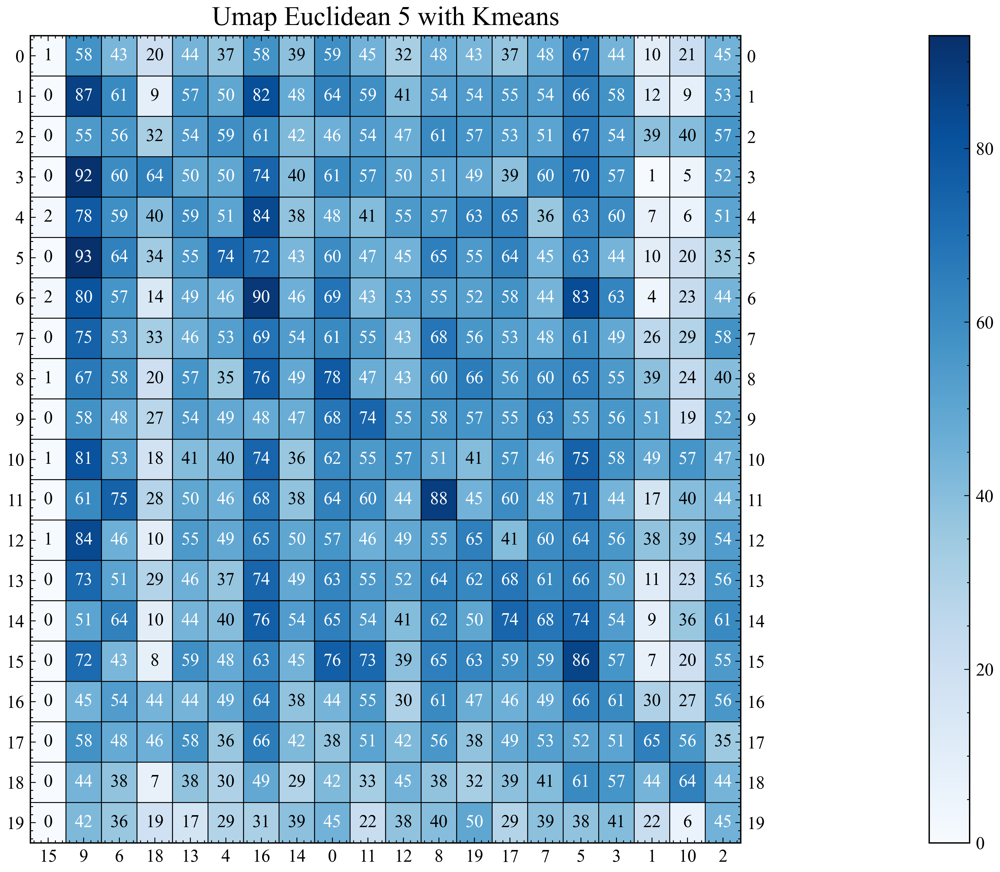

In [56]:
# Contigency matrix for euclidean, 5

labels_euclidean_5 = np.array(data["euclidean"]["5"][-1][0])
contingency = contingency_matrix(allTargets, labels_euclidean_5)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, title = "Umap Euclidean 5 with Kmeans", pic_fname = "Q11d.pdf", size=(8,7), textsize=10)


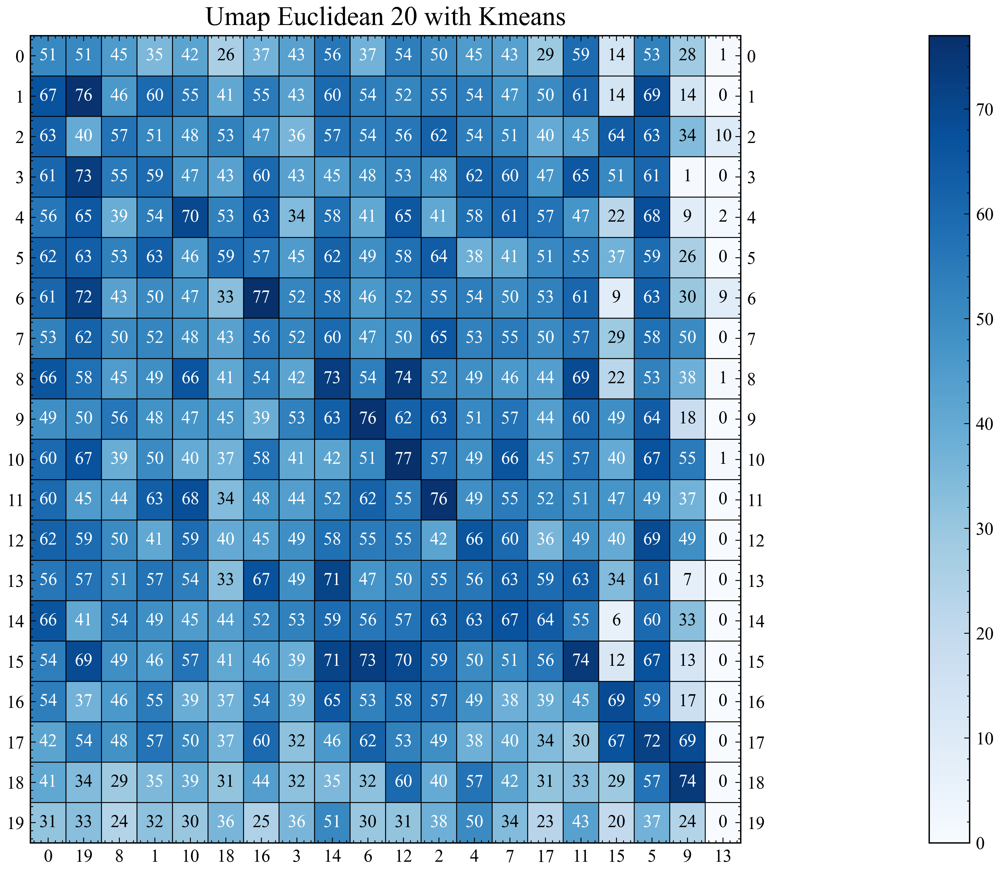

In [57]:
# Contigency matrix for euclidean, 20

labels_euclidean_20 = np.array(data["euclidean"]["20"][-1][0])
contingency = contingency_matrix(allTargets, labels_euclidean_20)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, title = "Umap Euclidean 20 with Kmeans", pic_fname = "Q11e.pdf", size=(8,7), textsize=10)



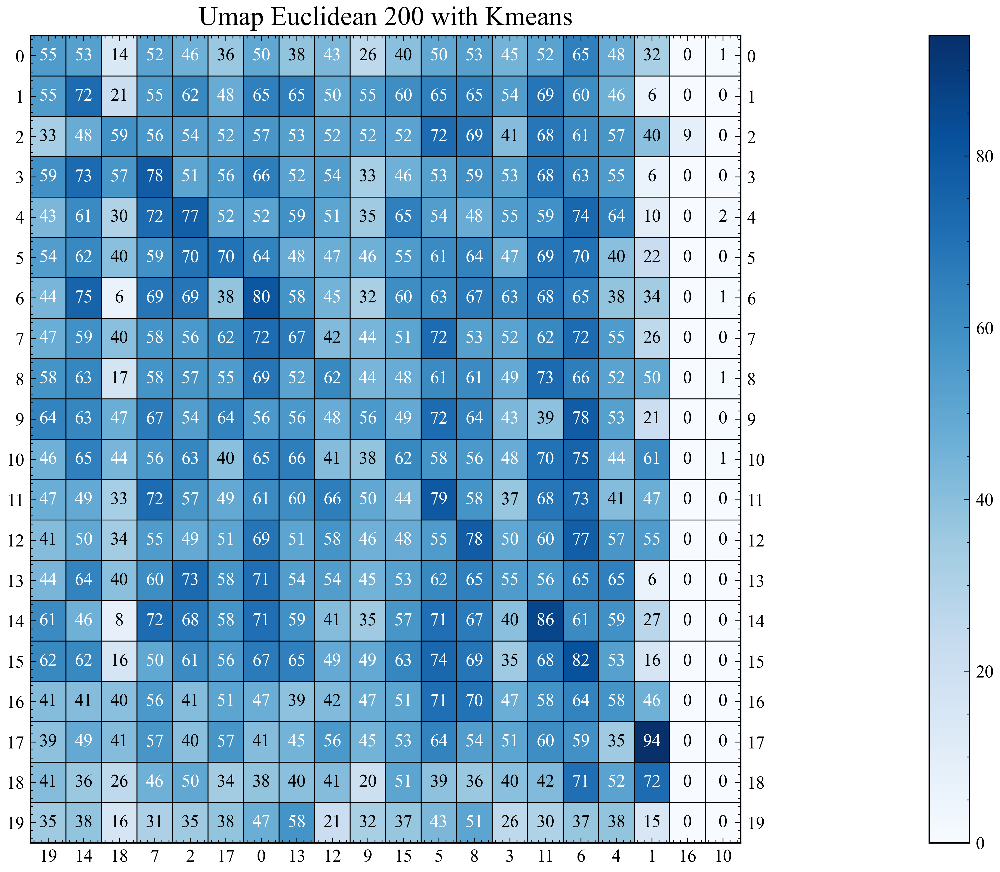

In [58]:
# Contigency matrix with euclidean, 200 

labels_euclidean_200 = np.array(data["euclidean"]["200"][-1][0])
contingency = contingency_matrix(allTargets, labels_euclidean_200)
rows, cols = linear_sum_assignment(contingency, maximize=True)
plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, title = "Umap Euclidean 200 with Kmeans", pic_fname = "Q11f.pdf", size=(8,7), textsize=10)

# Question 13 

Performing K means with 20 clusters on raw TFIDF data 

In [26]:
kMeans = KMeans(n_clusters=20, random_state=42, max_iter=4000, n_init = 60)
kMeans.fit(features)
labels = kMeans.labels_

# Calculate the metrics
allTargets = all_class_data.target
homogeneity = homogeneity_score(allTargets, labels)
completeness = completeness_score(allTargets, labels)
vMeasure = v_measure_score(allTargets, labels)
adjustedRand = adjusted_rand_score(allTargets, labels)
adjustedMutual = adjusted_mutual_info_score(allTargets, labels)
print(f"The homogeneity score is :\t{homogeneity:.4f} \nThe completeness score is :\t{completeness:.4f} \nThe V-measure score is :\t{vMeasure:.4f} \nThe adjusted Rand Index is :\t{adjustedRand:.4f} \nThe adjusted MI score is :\t{adjustedMutual:.4f}")

The homogeneity score is :	0.3665 
The completeness score is :	0.4256 
The V-measure score is :	0.3938 
The adjusted Rand Index is :	0.1307 
The adjusted MI score is :	0.3917


# Question 14 

In [40]:
import umap
from sklearn.cluster import AgglomerativeClustering

In [42]:

# Load all the data 
all_class_data = fetch_20newsgroups(subset='all', shuffle=True, random_state=0, remove=('headers', 'footers'))
allTargets = all_class_data.target

# Vectorize data and get TF-IDF
vectorizer = CountVectorizer(stop_words='english', min_df=3)
counts = vectorizer.fit_transform(all_class_data.data)
tfidfTran = TfidfTransformer()
features = tfidfTran.fit_transform(counts)
print(f"The dimensions of the TF-IDF matrix we obtain is {features.shape}")

The dimensions of the TF-IDF matrix we obtain is (18846, 45365)


In [28]:
# Using cosine UMAP with r = 5 as the standard since it has the best metrics 

embedding = umap.UMAP(n_components=5, metric='cosine').fit(features)



In [52]:
import numpy as np
from plotmat import plot_mat # using the provided plotmat.py 
from scipy.optimize import linear_sum_assignment
from sklearn.metrics import confusion_matrix

In [54]:
# Agglomerative Clustering using ward linkage 
clustering = AgglomerativeClustering(n_clusters = 20, linkage = 'ward')
clustering.fit(embedding.embedding_)
ward_linkage_labels = clustering.labels_

# Performance Metrics for Ward Linkage 
print("Homogenity Score : {}".format(homogeneity_score(allTargets, ward_linkage_labels)))
print("Completeness Score : {}".format(completeness_score(allTargets, ward_linkage_labels)))
print("V Measure Score : {}".format(v_measure_score(allTargets, ward_linkage_labels)))
print("Adjusted Rand Score : {}".format(adjusted_rand_score(allTargets, ward_linkage_labels)))
print("Adjusted Mutual Info Score : {}".format(adjusted_mutual_info_score(allTargets, ward_linkage_labels)))


Homogenity Score : 0.549327133288123
Completeness Score : 0.5874314859232634
V Measure Score : 0.5677406772411766
Adjusted Rand Score : 0.4130096879513567
Adjusted Mutual Info Score : 0.5662844263417892


In [55]:
# Agglomerative Clustering using Single linkage 
clustering = AgglomerativeClustering(n_clusters = 20, linkage = 'single')
clustering.fit(embedding.embedding_)
single_linkage_labels = clustering.labels_

# Performance Metrics for Single Linkage 
print("Homogenity Score : {}".format(homogeneity_score(allTargets, single_linkage_labels)))
print("Completeness Score : {}".format(completeness_score(allTargets, single_linkage_labels)))
print("V Measure Score : {}".format(v_measure_score(allTargets, single_linkage_labels)))
print("Adjusted Rand Score : {}".format(adjusted_rand_score(allTargets, single_linkage_labels)))
print("Adjusted Mutual Info Score : {}".format(adjusted_mutual_info_score(allTargets, single_linkage_labels)))


Homogenity Score : 0.006701920946209235
Completeness Score : 0.24156506716658185
V Measure Score : 0.013042007685537673
Adjusted Rand Score : -1.2066987108487083e-05
Adjusted Mutual Info Score : 0.008536038673014872


# Question 15 

In [57]:
!pip3 install hdbscan

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 31.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.29-cp38-cp38-linux_x86_64.whl size=3773977 sha256=754cbef90e381406e9c851b507ef438d90bfaa961951704da5bf93c4de32420e
  Stored in directory: /root/.cache/pip/wheels/76/06/48/527e038689c581cc9e519c73840efdc7473805149e55bd7ffd
Successfully built hdbscan


In [27]:
import hdbscan

In [63]:
# Performing HDBSCAN on UMAP transformed data

df = pd.DataFrame(columns = ["clustersize", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
clusters = [20, 100, 200]

for cluster in clusters:

  clusterer = hdbscan.HDBSCAN(min_cluster_size=cluster)
  clusterer.fit(embedding.embedding_)
  cluster_labels = clusterer.labels_
  df2 = pd.DataFrame(data = [[cluster, homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["clustersize", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
  df = df.append(df2, ignore_index = True)

df


,clustersize,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,20,0.000339,0.074967,0.000676,0.000001,0.000287
1,100,0.439081,0.573925,0.497529,0.222890,0.496171
2,200,0.409594,0.601859,0.487453,0.206448,0.486417


# Question 16

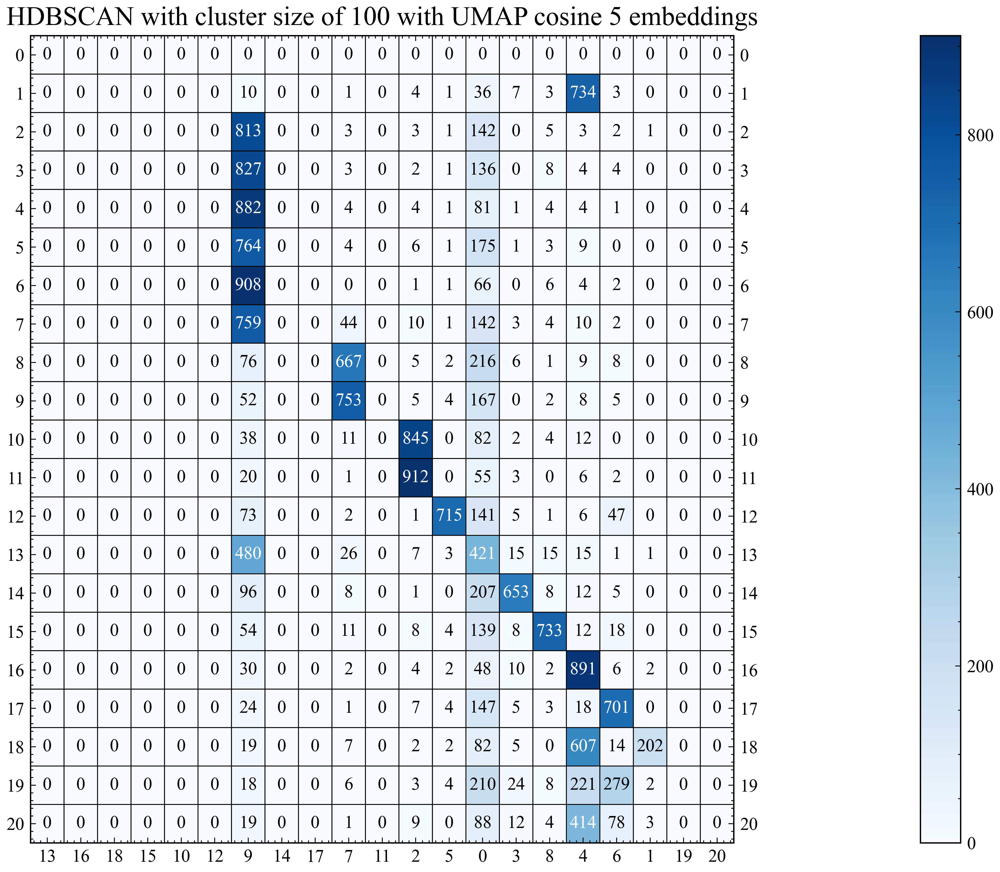

In [85]:
# Best Cluster has cluster size of 100 

clusterer = hdbscan.HDBSCAN(min_cluster_size=100)
clusterer.fit(embedding.embedding_)
cluster_labels = clusterer.labels_

#contingency = contingency_matrix(allTargets, cluster_labels)
#rows, cols = linear_sum_assignment(contingency, maximize=True)
#plot_mat(contingency[rows[:, np.newaxis], cols], cols, rows, title = "HDBSCAN with cluster size of 100 with UMAP cosine 5 embeddings", pic_fname = "Q16.pdf", size=(8,7), textsize=10)


cm = confusion_matrix(allTargets, cluster_labels)
rows, cols = linear_sum_assignment(cm, maximize=True)
plot_mat(cm[rows[:, np.newaxis], cols], cols, rows, title = "HDBSCAN with cluster size of 100 with UMAP cosine 5 embeddings", pic_fname = "Q16.pdf", size=(8,7), textsize=10)



# Question 17 

In [3]:
# Load all the data 
all_class_data = fetch_20newsgroups(subset='all', shuffle=True, random_state=0, remove=('headers', 'footers'))
allTargets = all_class_data.target

# Vectorize data and get TF-IDF
vectorizer = CountVectorizer(stop_words='english', min_df=3)
counts = vectorizer.fit_transform(all_class_data.data)
tfidfTran = TfidfTransformer()
features = tfidfTran.fit_transform(counts)
print(f"The dimensions of the TF-IDF matrix we obtain is {features.shape}")

# No transformation data stored in features 

The dimensions of the TF-IDF matrix we obtain is (18846, 45365)


In [7]:
import pickle 

In [8]:
# Perform SVD reductions 

r_vals= [5, 20, 200]

for r in r_vals:

    # Perform Dim reduction
    svd = TruncatedSVD(n_components=r, random_state=42)
    svdFeatures = svd.fit_transform(features)
    
    filename = "SVD_{}".format(r)
    
    outfile = open(filename,'wb')
    
    pickle.dump(svdFeatures,outfile)
    outfile.close()
    

In [12]:
# Perform NMF reductions 

r_vals= [5, 20, 200]

for r in tqdm(r_vals):

    # Perform Dim reduction
    nmf = NMF(n_components=r, random_state=42)
    nmfFeatures = nmf.fit_transform(features)
    
    filename = "NMF_{}".format(r)
    
    outfile = open(filename,'wb')
    
    pickle.dump(nmfFeatures,outfile)
    outfile.close()


100%|████████████████████████████████████████████| 3/3 [10:44<00:00, 214.87s/it]


In [6]:
import umap 

In [14]:
# Perform Umap reductions 

n_components = [5, 20, 200] 

for n in tqdm(n_components):
    
    embedding = umap.UMAP(n_components=n, metric='cosine').fit(features)
    umapFeatures = embedding.embedding_
    
    filename = "UMAP_{}".format(n)
    
    outfile = open(filename,'wb')
    
    pickle.dump(umapFeatures,outfile)
    outfile.close()



100%|█████████████████████████████████████████████| 3/3 [01:07<00:00, 22.61s/it]


In [22]:
files = [] 
dim_reds = ["SVD_" , "NMF_" , "UMAP_"]

for dim in dim_reds:
    
    for n in n_components:
        
        files.append(dim + str(n))
        
files

['SVD_5',
 'SVD_20',
 'SVD_200',
 'NMF_5',
 'NMF_20',
 'NMF_200',
 'UMAP_5',
 'UMAP_20',
 'UMAP_200']

In [20]:
import pandas as pd 

In [35]:
# Perform K means with different configs for each of the reductions 
 
k_vals = [10, 20, 50] 

df = pd.DataFrame(columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
for k in tqdm(k_vals):
    
    kMeans = KMeans(n_clusters=k, random_state=42, max_iter=4000, n_init = 60)
    
    # Load the feature vector 
    for filename in tqdm(files):
        
        infile = open(filename,'rb')
        embeddings = pickle.load(infile)
        infile.close()
        
        kMeans.fit(embeddings)
        cluster_labels = kMeans.labels_
        
        df2 = pd.DataFrame(data = [["Kmeans_{}".format(k), filename, homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
        df = df.append(df2, ignore_index = True)

df.to_csv("Kmeans_results.csv")
df

  0%|                                                     | 0/9 [00:00<?, ?it/s]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/654127922.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)

 11%|█████                                        | 1/9 [00:00<00:05,  1.38it/s]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/654127922.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)

 22%|██████████                                   | 2/9 [00:01<00:06,  1.07it/s]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/654127922.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_i

 56%|█████████████████████████                    | 5/9 [00:30<00:22,  5.72s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/654127922.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)

 67%|██████████████████████████████               | 6/9 [00:40<00:22,  7.36s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/654127922.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)

 78%|███████████████████████████████████          | 7/9 [00:43<00:11,  5.77s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/654127922.py:21: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_i

,Clustering,Dim_Red,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,Kmeans_10,SVD_5,0.270818,0.417772,0.328614,0.105844,0.327370
1,Kmeans_10,SVD_20,0.247398,0.407147,0.307778,0.075847,0.306462
2,Kmeans_10,SVD_200,0.272433,0.473325,0.345821,0.087200,0.344552
3,Kmeans_10,NMF_5,0.224424,0.366649,0.278425,0.072928,0.277057
4,Kmeans_10,NMF_20,0.170490,0.327286,0.224193,0.035063,0.222630
5,Kmeans_10,NMF_200,0.048282,0.189579,0.076963,0.003412,0.074671
6,Kmeans_10,UMAP_5,0.453307,0.637768,0.529945,0.336216,0.529093
7,Kmeans_10,UMAP_20,0.479425,0.655678,0.553867,0.348483,0.553082
8,Kmeans_10,UMAP_200,0.459334,0.650576,0.538479,0.334669,0.537641
9,Kmeans_20,SVD_5,0.321451,0.349859,0.335054,0.126457,0.332808


In [36]:
from sklearn.cluster import AgglomerativeClustering

In [37]:
# Perform aglo Clustering 

    
clustering = AgglomerativeClustering(n_clusters = 20, linkage = 'ward')
    
    # Load the feature vector 
for filename in tqdm(files):
        
    infile = open(filename,'rb')
    embeddings = pickle.load(infile)
    infile.close()

    clustering.fit(embeddings)
    cluster_labels = clustering.labels_    

    df2 = pd.DataFrame(data = [["Agglomerative_Clustering_20", filename, homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
    df = df.append(df2, ignore_index = True)

df.to_csv("Agglo_results.csv")
df

  0%|                                                     | 0/9 [00:00<?, ?it/s]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/3229563268.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
 11%|█████                                        | 1/9 [00:06<00:50,  6.37s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/3229563268.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
 22%|██████████                                   | 2/9 [00:11<00:41,  5.86s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/3229563268.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_

,Clustering,Dim_Red,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,Kmeans_10,SVD_5,0.270818,0.417772,0.328614,0.105844,0.327370
1,Kmeans_10,SVD_20,0.247398,0.407147,0.307778,0.075847,0.306462
2,Kmeans_10,SVD_200,0.272433,0.473325,0.345821,0.087200,0.344552
3,Kmeans_10,NMF_5,0.224424,0.366649,0.278425,0.072928,0.277057
4,Kmeans_10,NMF_20,0.170490,0.327286,0.224193,0.035063,0.222630
5,Kmeans_10,NMF_200,0.048282,0.189579,0.076963,0.003412,0.074671
6,Kmeans_10,UMAP_5,0.453307,0.637768,0.529945,0.336216,0.529093
7,Kmeans_10,UMAP_20,0.479425,0.655678,0.553867,0.348483,0.553082
8,Kmeans_10,UMAP_200,0.459334,0.650576,0.538479,0.334669,0.537641
9,Kmeans_20,SVD_5,0.321451,0.349859,0.335054,0.126457,0.332808


In [39]:
import hdbscan

In [48]:
clusterer = hdbscan.HDBSCAN(min_cluster_size=100)

infile = open("SVD_5",'rb')
embeddings = pickle.load(infile)
infile.close()

clusterer.fit(embeddings)
cluster_labels = clusterer.labels_
df2 = pd.DataFrame(data = [["HDBSCAN_{}".format(100), "SVD_5", homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])

df2

,Clustering,Dim_Red,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,HDBSCAN_100,SVD_5,0.0,1.0,0.0,0.0,0.0


In [40]:
# Perform HDBSCAN 

clusters = [100, 200] 

for cluster in tqdm(clusters):
    
    clusterer = hdbscan.HDBSCAN(min_cluster_size=cluster)

    for filename in tqdm(files):

        infile = open(filename,'rb')
        embeddings = pickle.load(infile)
        infile.close()


        clusterer.fit(embeddings)
        cluster_labels = clusterer.labels_
        df2 = pd.DataFrame(data = [["HDBSCAN_{}".format(cluster), filename, homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
        df = df.append(df2, ignore_index = True)


df.to_csv("HDBSCAN.csv")
df


  0%|                                                     | 0/9 [00:00<?, ?it/s]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/1219875959.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)

 11%|█████                                        | 1/9 [00:01<00:10,  1.28s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/1219875959.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)

 22%|██████████                                   | 2/9 [00:02<00:08,  1.24s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/1219875959.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignor

,Clustering,Dim_Red,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,Kmeans_10,SVD_5,0.270818,0.417772,0.328614,0.105844,0.327370
1,Kmeans_10,SVD_20,0.247398,0.407147,0.307778,0.075847,0.306462
2,Kmeans_10,SVD_200,0.272433,0.473325,0.345821,0.087200,0.344552
3,Kmeans_10,NMF_5,0.224424,0.366649,0.278425,0.072928,0.277057
4,Kmeans_10,NMF_20,0.170490,0.327286,0.224193,0.035063,0.222630
5,Kmeans_10,NMF_200,0.048282,0.189579,0.076963,0.003412,0.074671
6,Kmeans_10,UMAP_5,0.453307,0.637768,0.529945,0.336216,0.529093
7,Kmeans_10,UMAP_20,0.479425,0.655678,0.553867,0.348483,0.553082
8,Kmeans_10,UMAP_200,0.459334,0.650576,0.538479,0.334669,0.537641
9,Kmeans_20,SVD_5,0.321451,0.349859,0.335054,0.126457,0.332808


In [42]:
# Full Feature list results 

k_vals = [10, 20, 50] 

for k in tqdm(k_vals):
    
    kMeans = KMeans(n_clusters=k, random_state=42, max_iter=4000, n_init = 60)

    kMeans.fit(features)
    cluster_labels = kMeans.labels_

    df2 = pd.DataFrame(data = [["Kmeans_{}".format(k), "Full Feature Set", homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
    df = df.append(df2, ignore_index = True)

df.to_csv("Kmeans_results.csv")
df

  0%|                                                     | 0/3 [00:00<?, ?it/s]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/1514521061.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
 33%|███████████████                              | 1/3 [00:48<01:37, 48.77s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/1514521061.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
 67%|██████████████████████████████               | 2/3 [02:06<01:05, 65.84s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_3594/1514521061.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_

,Clustering,Dim_Red,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,Kmeans_10,SVD_5,0.270818,0.417772,0.328614,0.105844,0.327370
1,Kmeans_10,SVD_20,0.247398,0.407147,0.307778,0.075847,0.306462
2,Kmeans_10,SVD_200,0.272433,0.473325,0.345821,0.087200,0.344552
3,Kmeans_10,NMF_5,0.224424,0.366649,0.278425,0.072928,0.277057
4,Kmeans_10,NMF_20,0.170490,0.327286,0.224193,0.035063,0.222630
5,Kmeans_10,NMF_200,0.048282,0.189579,0.076963,0.003412,0.074671
6,Kmeans_10,UMAP_5,0.453307,0.637768,0.529945,0.336216,0.529093
7,Kmeans_10,UMAP_20,0.479425,0.655678,0.553867,0.348483,0.553082
8,Kmeans_10,UMAP_200,0.459334,0.650576,0.538479,0.334669,0.537641
9,Kmeans_20,SVD_5,0.321451,0.349859,0.335054,0.126457,0.332808


In [ ]:
# Full Feature list results, takes too long to run 

clustering = AgglomerativeClustering(n_clusters = 20, linkage = 'ward')
dense_features = features.toarray()
clustering.fit(dense_features)
cluster_labels = clustering.labels_    


df2 = pd.DataFrame(data = [["Agglomerative_Clustering_20", "Full Feature Set", homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
df = df.append(df2, ignore_index = True)

df.to_csv("All_results.csv")
df

In [87]:
df = pd.read_csv("Kmeans_results.csv")

In [89]:
# Full Feature list HDBSCAN, takes too long to run 

clusters = [100, 200]

for cluster in tqdm(clusters):
    
    clusterer = hdbscan.HDBSCAN(min_cluster_size=cluster)

    clusterer.fit(features)
    cluster_labels = clusterer.labels_

    df2 = pd.DataFrame(data = [["HDBSCAN_{}".format(cluster), "Full Feature Set", homogeneity_score(allTargets, cluster_labels), completeness_score(allTargets, cluster_labels), v_measure_score(allTargets, cluster_labels), adjusted_rand_score(allTargets, cluster_labels), adjusted_mutual_info_score(allTargets, cluster_labels)]], columns = ["Clustering", "Dim_Red", "homogeneity_score", "completeness_score", "v_measure_score", "adjusted_rand_score", "adjusted_mutual_info_score"])
    df = df.append(df2, ignore_index = True)

df.to_csv("Q17_results.csv")
df

  0%|                                                     | 0/2 [00:00<?, ?it/s]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_5272/3955533376.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
 50%|██████████████████████▌                      | 1/2 [00:19<00:19, 19.69s/it]/var/folders/rt/cz01pnk54lsf_lv342qgjmgc0000gn/T/ipykernel_5272/3955533376.py:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(df2, ignore_index = True)
100%|█████████████████████████████████████████████| 2/2 [00:37<00:00, 18.52s/it]


,Clustering,Dim_Red,homogeneity_score,completeness_score,v_measure_score,adjusted_rand_score,adjusted_mutual_info_score
0,Kmeans_10,SVD_5,0.27081818,0.417772436,0.328614327,0.105844334,0.327370325
1,Kmeans_10,SVD_20,0.247397663,0.407146986,0.307777973,0.075847201,0.306462414
2,Kmeans_10,SVD_200,0.272433197,0.473325236,0.345821118,0.087200439,0.344551995
3,Kmeans_10,NMF_5,0.224424036,0.366649394,0.278425429,0.072928042,0.277056985
4,Kmeans_10,NMF_20,0.170489599,0.327285878,0.224192796,0.03506259,0.22262952
...,...,...,...,...,...,...,...
57,Agglomerative_Clustering_20,Full Feature Set,Timeout,Timeout,Timeout,Timeout,Timeout
58,HDBSCAN_100,Full Feature Set,Timeout,Timeout,Timeout,Timeout,Timeout
59,HDBSCAN_200,Full Feature Set,Timeout,Timeout,Timeout,Timeout,Timeout
60,HDBSCAN_100,Full Feature Set,0.0,1.0,0.0,0.0,0.0


# Question 18 

In [4]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('all-MiniLM-L6-v2')

#Our sentences we like to encode
sentences = all_class_data.data

#Sentences are encoded by calling model.encode()
embeddings = model.encode(sentences)

#Print the embeddings
for sentence, embedding in zip(sentences, embeddings):
    print("Sentence:", sentence)
    print("Embedding:", embedding)
    print("")




Sentence: FOR SALE

                 1945 King Feature Syndicate
                 Jaymar Specialty Company
                 200 Fifth Avenue New York, NY

                 Cardboard puzzle - NO BOX
                 Pieces worn from use
                 NO MISSING PIECES
                 Size: 13 3/4 inches by 21 1/2 inches
                 60 Puzzle Pieces

   Puzzle depicts Dagwood, Blondie, the kids, and dog Daisey with her
   puppies on a picnic with Dagwood and Alexander trying to get
   a fishing line out of a tree.
Embedding: [-9.28232893e-02  1.87146667e-04  2.68489756e-02 -9.75217111e-03
 -8.57465044e-02  6.60854334e-04 -3.52468491e-02 -4.35369201e-02
 -2.10950114e-02  1.49691347e-02 -2.09950861e-02  2.02811416e-02
 -4.51396108e-02 -5.35933822e-02 -9.89280641e-03  3.92540172e-02
  3.76981199e-02  2.31426079e-02 -2.72115152e-02 -9.83007401e-02
 -4.05130312e-02 -8.35683867e-02 -2.38967482e-02  9.84323118e-03
  1.44345984e-02  4.98891585e-02 -4.78423871e-02  4.26277854e-02
  2.034

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[-3.47284153e-02  7.38651752e-02  1.30397538e-02  2.96692755e-02
  1.22185268e-01  2.08484624e-02 -2.16737427e-02  7.05971476e-03
  3.80654484e-02  2.79949326e-02  2.96111219e-02 -8.18932429e-02
 -4.31600735e-02 -1.86592583e-02 -8.21903944e-02 -2.05996558e-02
 -2.27390919e-02 -4.17210422e-02 -5.42957969e-02  5.67840934e-02
 -3.78506351e-03  2.02961471e-02  5.17907105e-02  5.45085557e-02
 -2.75737909e-03 -7.57805863e-03  1.88905075e-02  4.59526181e-02
  4.87376824e-02  3.85795459e-02  2.41061370e-03  1.25360101e-01
  3.11118402e-02 -2.19242019e-03 -1.71084274e-02  1.25041567e-02
  5.05380481e-02  2.47636009e-02  4.70458753e-02  1.27519956e-02
 -2.93062301e-03  1.44405402e-02 -2.07535271e-02 -6.40960759e-04
  5.24488799e-02  4.94152866e-02 -1.57156754e-02 -4.21287231e-02
 -3.94826122e-02  2.60413270e-02 -1.27702534e-01  4.25825827e-02
 -1.35040074e-03 -5.13425358e-02 -2.80983909e-03  9.70907975e-03
 -1.95366759e-02 -2.80078687e-02 -1.58286910e-03 -1.00966133e-01
  1.05022557e-01 -1.04420

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)





Sentence: rls@uihepa.hep.uiuc.edu (Ray Swartz (Oh, that guy again)) writes:

>The gravity maneuvering that was used was to exploit 'fuzzy regions'.  These
>are described by the inventor as exploiting the second-order perturbations in a
>three body system.  The probe was launched into this region for the
>earth-moon-sun system, where the perturbations affected it in such a way as to
>allow it to go into lunar orbit without large expenditures of fuel to slow
>down. The idea is that 'natural objects sometimes get captured without
>expending fuel, we'll just find the trajectory that makes it possible". The
>originator of the technique said that NASA wasn't interested, but that Japan
>was because their probe was small and couldn't hold a lot of fuel for
>deceleration.


I should probably re-post this with another title, so that
the guys on the other thread would see that this is a practical
use of "temporary orbits..."

Another possible temporary orbit:

Embedding: [-8.19237381e-02  3.663

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[-6.94346800e-02  6.66229129e-02  3.78530063e-02 -7.11710677e-02
  1.34339007e-02  3.45992483e-02 -4.16248627e-02 -4.64403704e-02
  1.17634200e-01  4.11601886e-02 -6.98274001e-02  1.39392674e-01
  2.53797765e-03 -1.26027465e-01 -1.29570328e-02 -3.75176743e-02
 -1.06109291e-01 -1.36808380e-02 -8.45894516e-02  2.46302574e-04
 -5.27651173e-05  6.71988353e-02 -2.71337852e-02  3.76744978e-02
  1.56550147e-02  9.93998945e-02 -5.02026565e-02 -6.47515357e-02
  2.86187287e-02 -3.03813629e-02  1.26061332e-03  4.00723331e-02
 -1.26116285e-02 -1.18212458e-02  1.46882385e-02  3.42336632e-02
  1.28519818e-01  4.42094393e-02  7.60776782e-03 -4.50778157e-02
  4.68222164e-02  8.43355283e-02 -3.49691659e-02 -6.43183291e-02
 -1.95609331e-02  4.44224104e-02 -6.84450567e-02 -4.83986363e-02
  3.73769850e-02 -5.03583346e-04 -1.16897158e-01 -5.83356991e-02
  6.93361759e-02 -3.41697335e-02  1.78299728e-04 -5.55858191e-04
  3.07088327e-02  6.60067424e-02 -9.50079411e-03 -8.40120539e-02
 -4.25180644e-02  5.76189

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 1.03182998e-03 -3.39500397e-03 -1.04916438e-01  3.36864940e-03
 -2.49879365e-03  1.94604471e-02  4.73073795e-02  1.96949579e-03
  1.20655308e-02  2.06410643e-02 -5.29309222e-03  5.29486202e-02
 -3.50622670e-03  9.73177303e-05 -3.82293165e-02  3.37381773e-02
  3.57642286e-02 -1.15175970e-01 -4.35502306e-02  1.17154829e-01
 -1.56612977e-01 -6.42487081e-03 -5.24069965e-02 -7.90814981e-02
 -5.08890115e-02 -4.23577130e-02 -4.81387042e-03  1.68507807e-02
 -6.88785985e-02 -4.20862474e-02  4.51545455e-02  1.18381400e-02
  5.00457920e-02 -7.35267019e-03 -2.62891892e-02  1.79749243e-02
  4.61222744e-03  2.89685894e-02  3.59405205e-02  1.67730935e-02
  3.02697290e-02  4.73342240e-02 -1.36409467e-02 -2.13782652e-03
 -3.01066805e-02  1.65876634e-02  9.70704202e-03  1.34522179e-02
 -3.51325497e-02 -1.04783900e-01 -6.40660375e-02  2.72536073e-02
  2.71138512e-02 -4.46904637e-03 -1.89962406e-02 -5.32083772e-03
 -3.60433385e-02 -5.88839650e-02 -1.82214696e-02 -8.95623211e-03
 -9.58538614e-03  6.54702

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[ 3.00879702e-02 -1.29841883e-02 -3.43192928e-02  1.62525997e-02
  1.13613659e-03  1.93549891e-03  6.19612560e-02  1.27591714e-02
 -1.51195545e-02 -4.61540073e-02  2.48137526e-02 -2.50388719e-02
  5.34628667e-02 -5.30638248e-02  8.37684143e-03 -9.77537967e-03
  9.45506021e-02  9.62847192e-03 -3.56821343e-02  1.44873202e-01
 -7.84569830e-02 -4.35300060e-02  1.87971350e-02  3.03986054e-02
 -9.39641818e-02  3.12641710e-02 -6.18033595e-02 -5.80204539e-02
 -5.13153449e-02  5.40589355e-03 -7.31096789e-02 -4.21959488e-03
  1.22053465e-02 -5.18551841e-02 -4.40177619e-02 -2.26059631e-02
  8.81753117e-03 -6.15599751e-03  2.54157670e-02  3.82423066e-02
 -1.20898755e-02 -5.00378832e-02  3.77908237e-02  9.12510678e-02
 -2.70713065e-02 -4.55604168e-03 -1.23999203e-02 -2.81310920e-02
  3.11461762e-02 -7.43430704e-02 -2.52105221e-02  2.39420254e-02
  5.78077175e-02 -8.08366537e-02  3.63612920e-02 -3.01351864e-03
 -8.50175619e-02  4.84040901e-02 -3.99855562e-02  6.94527030e-02
 -3.03412927e-03 -3.26305

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [5]:
embeddings.shape

(18846, 384)

In [7]:
import umap

In [8]:
# Perform UMAP reduction on clustering 

umapembedding = umap.UMAP(n_components=20, metric='cosine').fit(embeddings)
umapFeatures = umapembedding.embedding_



In [10]:
import pandas as pd

In [13]:
allTargets = all_class_data.target

In [17]:
# Perform Agglo Clustering on UMAP reduced data 

clustering = AgglomerativeClustering(n_clusters = 20, linkage = 'ward')

clustering.fit(umapFeatures)
cluster_labels = clustering.labels_    


print("Homogenity Score : {}".format(homogeneity_score(allTargets, cluster_labels)))
print("Completeness Score : {}".format(completeness_score(allTargets, cluster_labels)))
print("V Measure Score : {}".format(v_measure_score(allTargets, cluster_labels)))
print("Adjusted Rand Score : {}".format(adjusted_rand_score(allTargets, cluster_labels)))
print("Adjusted Mutual Info Score : {}".format(adjusted_mutual_info_score(allTargets, cluster_labels)))



Homogenity Score : 0.6105513290431609
Completeness Score : 0.6484485105041435
V Measure Score : 0.6289295478333338
Adjusted Rand Score : 0.4692826180285166
Adjusted Mutual Info Score : 0.6276862563329677
